# Introduction
Bangalore is the capital of the Indian state of Karnataka. It has a population of over ten million, making it a megacity and the third-most populous city and fifth-most populous urban agglomeration in India. It is located in southern India, on the Deccan Plateau at an elevation of over 900 m (3,000 ft) above sea level, which is the highest among India's major cities.Its multi-ethnic, multi-religious, and cosmopolitan nature is reflected in the varied cuisines serving restaurants.
The diversity of cuisine is reflective of the social and economic diversity of Bangalore.Bangalore has a wide and varied mix of restaurant types and cuisines and Bangaloreans deem eating out as an intrinsic part of their culture. Roadside vendors, tea stalls, and South Indian, North Indian, Chinese and Western fast food are all very popular in the city.
Bangalore is also 'Silicon valley of India'. In this assignment, we are doing a survey of famous cafe locations of the famous 'IT hub' of India.Having said that, lot of people from all over India settle in the silicon valley for jobs. 
So as part of this project , we will list and visualize all major parts of Banaglore that has great cafes and restaurants and I will suggest where we can open a new cafe if someone is looking to open a business.
### Data
For this project we need the following data :

- Zomato api data
- Foursquare api to derive venues for neighbourhood information
- GeoSpace data - Latitude,longitude for given cafes

### Approach
- Collect bangalore restaurant data from zomato api
- Filter out all venues that are cafes.
- Using geopy find latitude, longitude for given cafes.
- Using FourSquare API we will find all venues for each neighborhood.
- Using rating for each resturant , we will sort that data.
- Cluster using appropriate algorithm
- Visualize the Ranking of neighborhoods using folium library(python)

### Usecases
- What is best location in Banglore for cafes ? 
- Which all areas lack cafes ?
- Which areas have potential cafes?
- Which is the best place to stay if I prefer cafes in the city?

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import requests
from bs4 import BeautifulSoup
import geocoder
import os
import folium # map rendering library
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
%matplotlib inline

print('Libraries imported.')

Libraries imported.


In [2]:
df = pd.read_csv('zomato.csv')

In [3]:
df.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


In [4]:
df = df[(df['cuisines'].str.contains('Cafe')==True) | (df.rest_type.str.contains('Cafe')==True)].reset_index(drop=True)

In [5]:
df.shape

(5358, 17)

In [6]:
df.columns

Index(['url', 'address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [7]:
df = df[['address','name','rate','location']]

In [8]:
df.shape

(5358, 4)

In [9]:
df['rateon5'] = df['rate'].apply(lambda x: str(x).split('/')[0])

In [10]:
df.head()

,address,name,rate,location,rateon5
0,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,3.8/5,Banashankari,3.8
1,"2469, 3rd Floor, 24th Cross, Opposite BDA Comp...",Onesta,4.6/5,Banashankari,4.6
2,"1, 30th Main Road, 3rd Stage, Banashankari, Ba...",Penthouse Cafe,4.0/5,Banashankari,4.0
3,"2470, 21 Main Road, 25th Cross, Banashankari, ...",Smacznego,4.2/5,Banashankari,4.2
4,"12,29 Near PES University Back Gate, D'Souza N...",CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1/5,Banashankari,4.1


In [11]:
nom=Nominatim(user_agent="my-application") 

In [12]:
coordinate =[]
for count,ad in enumerate(df.address):
    print(count)
    try: 
        target1=nom.geocode(ad)[1]
        print(target1)
        coordinate.append(target1)
    except :
        try:
            coordinate.append(nom.geocode(df.iloc[count]['location'])[1])
        except:
            coordinate.append('')
            pass

0
1
2
3
4
5
6
(12.9320164, 77.5479792)
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
(12.9320164, 77.5479792)
58
59
60
61
62
63
64
65
66
67
(12.9320164, 77.5479792)
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
(12.914314749999999, 77.59951981866996)
93
94
95
96
97
98
99
100
101
102
103
104
(12.907488050000001, 77.60114313941907)
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
(12.914314749999999, 77.59951981866996)
188
189
190
191
192
193
194
195
196
197
(12.907488050000001, 77.60114313941907)
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
(12.9263681, 77.580

1638
1639
1640
1641
1642
1643
1644
1645
1646
1647
1648
1649
1650
1651
1652
1653
1654
1655
1656
1657
1658
1659
1660
1661
1662
1663
1664
1665
1666
1667
1668
1669
1670
1671
1672
1673
1674
1675
1676
1677
1678
1679
1680
1681
1682
1683
1684
1685
1686
1687
1688
1689
1690
1691
1692
1693
1694
1695
1696
1697
1698
1699
1700
1701
1702
1703
1704
1705
1706
1707
1708
1709
1710
1711
1712
1713
1714
1715
1716
1717
1718
1719
1720
1721
1722
1723
1724
1725
1726
1727
1728
1729
1730
1731
1732
1733
1734
1735
1736
1737
1738
1739
1740
1741
1742
1743
1744
1745
1746
1747
1748
1749
1750
1751
1752
1753
1754
1755
1756
1757
1758
1759
1760
1761
1762
1763
1764
1765
1766
1767
1768
1769
1770
1771
1772
1773
1774
1775
1776
1777
1778
1779
1780
1781
1782
1783
1784
1785
1786
1787
1788
1789
1790
1791
1792
1793
1794
1795
1796
1797
1798
1799
1800
1801
1802
1803
1804
1805
1806
1807
1808
1809
1810
1811
1812
1813
1814
1815
1816
1817
1818
1819
1820
1821
1822
1823
1824
1825
1826
1827
1828
1829
1830
1831
1832
1833
1834
1835
1836
1837


3277
3278
3279
3280
3281
3282
3283
3284
3285
3286
3287
3288
3289
3290
3291
3292
3293
3294
3295
3296
3297
3298
3299
3300
3301
3302
3303
3304
3305
3306
3307
3308
3309
3310
3311
3312
3313
3314
3315
3316
3317
3318
3319
3320
3321
3322
3323
3324
3325
3326
3327
3328
3329
3330
3331
3332
3333
3334
3335
3336
3337
3338
3339
3340
3341
3342
3343
3344
3345
3346
3347
3348
3349
3350
3351
3352
3353
3354
3355
3356
3357
3358
3359
3360
3361
3362
3363
3364
3365
3366
3367
3368
3369
3370
3371
3372
3373
3374
3375
3376
3377
3378
3379
3380
3381
3382
3383
3384
3385
3386
3387
3388
3389
3390
3391
3392
3393
3394
3395
3396
3397
3398
3399
3400
3401
3402
3403
3404
3405
3406
3407
3408
3409
3410
3411
3412
3413
3414
3415
3416
3417
3418
3419
3420
3421
3422
3423
3424
3425
3426
3427
3428
3429
3430
3431
3432
3433
3434
3435
3436
3437
3438
3439
3440
3441
3442
3443
3444
3445
3446
3447
3448
3449
3450
3451
3452
3453
3454
3455
3456
3457
3458
3459
3460
3461
3462
3463
3464
3465
3466
3467
3468
3469
3470
3471
3472
3473
3474
3475
3476


4906
4907
4908
4909
4910
4911
4912
4913
4914
4915
4916
4917
4918
4919
4920
4921
4922
4923
4924
4925
4926
4927
4928
4929
4930
4931
4932
4933
4934
4935
4936
4937
4938
4939
4940
4941
4942
4943
4944
4945
4946
4947
4948
4949
4950
4951
4952
4953
4954
4955
4956
4957
4958
4959
4960
4961
4962
4963
4964
4965
4966
4967
4968
4969
4970
4971
4972
4973
4974
4975
4976
4977
4978
4979
4980
4981
4982
4983
4984
4985
4986
4987
4988
4989
4990
4991
4992
4993
4994
4995
4996
4997
4998
4999
5000
5001
5002
5003
5004
5005
5006
5007
5008
5009
5010
5011
5012
5013
5014
5015
5016
5017
5018
5019
5020
5021
5022
5023
5024
5025
5026
5027
5028
5029
5030
5031
5032
5033
5034
5035
5036
5037
5038
5039
5040
5041
5042
5043
5044
5045
5046
5047
5048
5049
5050
5051
5052
5053
5054
5055
5056
5057
5058
5059
5060
5061
5062
5063
5064
5065
5066
5067
5068
5069
5070
5071
5072
5073
5074
5075
5076
5077
5078
5079
5080
5081
5082
5083
5084
5085
5086
5087
5088
5089
5090
5091
5092
5093
5094
5095
5096
5097
5098
5099
5100
5101
5102
5103
5104
5105


In [13]:
len(coordinate)

5358

In [14]:
df.shape

(5358, 5)

In [15]:
df['co-ord'] = coordinate

In [16]:
df = df[df['co-ord']!=''].reset_index(drop=True)

In [17]:
#df.to_csv('zomato_wit_co-ords.csv',index=False)

In [18]:
#df = pd.read_csv('zomato_wit_co-ords.csv')

In [19]:
df.head()

,address,name,rate,location,rateon5,co-ord
0,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,3.8/5,Banashankari,3.8,"(15.8876779, 75.7046777)"
1,"2469, 3rd Floor, 24th Cross, Opposite BDA Comp...",Onesta,4.6/5,Banashankari,4.6,"(15.8876779, 75.7046777)"
2,"1, 30th Main Road, 3rd Stage, Banashankari, Ba...",Penthouse Cafe,4.0/5,Banashankari,4.0,"(15.8876779, 75.7046777)"
3,"2470, 21 Main Road, 25th Cross, Banashankari, ...",Smacznego,4.2/5,Banashankari,4.2,"(15.8876779, 75.7046777)"
4,"12,29 Near PES University Back Gate, D'Souza N...",CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1/5,Banashankari,4.1,"(15.8876779, 75.7046777)"


Since lots of restaurants in zomato api couldnt be found with geopy co-ordinates, lets look them up in the neighbour hoods of already existing co-ordinates that cover all the locations, using foursquare .

In [20]:
venues=pd.DataFrame(columns=['ID','Name','Category','loc_idx'])
i=0
j=0
def get_venues(series):
    global venue_details
    global i
    global j
    #set variables
    radius=1000
    LIMIT=100
    CLIENT_ID = 'YOJPDT333XBEG3OV33J1IAER3MKGZCPYZKNAN0EAZ2SWCS4U' # your Foursquare ID
    CLIENT_SECRET = 'XMGOTFUD4Y1BV4INBIAK0ZPXQTCLQPCNSG0UD1WHLTGYKBZS' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version

    lat = series[0]
    lng = series[1]

    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    # get all the data
    results = requests.get(url).json()
    print(results)
    try:
        venue_data=results["response"]['groups'][0]['items']
        print(len(venue_data))

        for row in venue_data:
            try:
                venue_id=row['venue']['id']
                venue_name=row['venue']['name']
                venue_category=row['venue']['categories'][0]['name']
                venues.loc[i]=[venue_id,venue_name,venue_category,df.location.iloc[j]]
            except :
                pass
            i=i+1
    except:
        pass
    j=j+1
    return 


In [21]:
df['co-ord'].apply(lambda x:get_venues(x))

{'meta': {'code': 200, 'requestId': '5e1f4d3a95feaf001b3ed429'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4d4e0f596800220cb6f4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4d9378a484001bf36374'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4dc947b43d00233aeb1c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4dc46001fe001b21df24'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4d4795feaf001b3f1643'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw':

{'meta': {'code': 200, 'requestId': '5e1f4d94b9a389001b24fcfc'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4d813907e7002239c634'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4d38bae9a20026809cde'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4d5e211536001c40020c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw':

{'meta': {'code': 200, 'requestId': '5e1f4dd00be7b4001bb1cc60'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4d6571c428001b2e9aad'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75

{'meta': {'code': 200, 'requestId': '5e1f4d0a660a9f0025027765'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4dd7949393001bfe3f0c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4dee47b43d00233ba4f2'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4de9f7706a001ca84547'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4dc278a484001bf44c02'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dc6d03993001b05d7da'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d52bae9a20026811a8f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e1c1a4b0a001b9b6097'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d13aba297001c2777f9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dc678a484001bf4607f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dce1e152c001b198a40'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dba98205d001bcf2359'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d8ab4b684001bc3a8ee'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4de4542890001ba19251'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'JP Nagar', 'headerFullLocation': 'JP Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 80, 'suggestedBounds': {'ne': {'lat': 12.923314759000007, 'lng': 77.60873614708319}, 'sw': {'lat': 12.90531474099999, 'lng': 77.59030349025673}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c8a413b6418a1430407dece', 'name': 'Corner House', 'location': {'address': '#1225, Near Ragi Gudda Temple', 'crossStreet': '26th Main, 9th Blk, Jayanagar', 'lat': 12.917455111168643, 'lng': 77.59328023350446, 'labeledLatLngs': [{'label': 'display', 'lat': 12.917455111168643, 'lng': 77.59328023350446}], 'distance

{'meta': {'code': 200, 'requestId': '5e1f4dcb78a484001bf478db'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e365fb726001be87eab'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4db99388d7001b6f38d3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4ddfedbcad001bf64013'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d8f882fc7001bb26bbf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dd1ad1ab4001c93c9e9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d8771c428001b2f41bb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d7d95feaf001b401abb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d831d67cb001b9a4254'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e079fcb92001b760f2b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d76006dce001b546973'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4de7edbcad001bf664cb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 12.91648805900001, 'lng': 77.61035921611492}, 'sw': {'lat': 12.898488040999993, 'lng': 77.59192706272322}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a54eda40802d413e056c732', 'name': 'PVR Cinemas', 'location': {'lat': 12.90762219988017, 'lng': 77.6010821476588, 'labeledLatLngs': [{'label': 'display', 'lat': 12.90762219988017, 'lng': 77.6010821476588}], 'distance': 16, 'postalCode': '560068', 'cc': 'IN', 'city': 'Bengaluru South', 'state': 'Karnātaka', '

{'meta': {'code': 200, 'requestId': '5e1f4df59da7ee001bffe966'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4da2a2e538001b20adc6'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e301a4b0a001b9bc62a'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e0a618f43001b0833ca'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4d9271c428001b2f7d23'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e0d618f43001b08426c'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e47df2774001c3fb460'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4d76963d29001b867d4c'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4de1b1cac0001bdbbc3c'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4dd4b9a389001b263b4c'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4df060ba08001b7d22a5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4d88006dce001b54c71c'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4dead03993001b0692eb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4e116001fe001b236068'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4df383525f001babdf8e'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e12be61c9001b024e92'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4dca3907e700223b3319'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e080de0d9001b0d3f35'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4da51835dd001b59c8ef'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4d7a40a7ea001c2055fa'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4df069babe001baeacce'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4e0e216785001be4b7ed'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4df369babe001baebe2d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4de29388d7001b700d68'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4d6b29ce6a001b49b003'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4d8f963d29001b86fe65'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4d9c006dce001b552d77'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4dd93907e700223b804b'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4daf211536001c419c49'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.87

{'meta': {'code': 200, 'requestId': '5e1f4e057828ae001bba931e'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4df447e0d6002590dd16'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4cf302a172002866dda5'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4db01d67cb001b9b2e47'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4db771c428001b303bff'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e1f9da7ee001b00c8b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4dd5760a7f001b3f120a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e0f60ba08001b7dc1e8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d52aba297001c28bbed'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dc50f596800220f0b0d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e0ad03993001b07338a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d96bae9a20026827678'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4de53907e700223bc10f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 1

{'meta': {'code': 200, 'requestId': '5e1f4d9440a7ea001c20d8b7'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e2f949393001bfffa0a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4e0cb1cac0001bdc98df'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e31949393001b000563'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4de0760a7f001b3f48e5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d66660a9f002504479d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d8329ce6a001b4a2924'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e0298205d001bd09494'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e396001fe001b242d15'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e2ac94979001bfd1af0'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e38949393001b002788'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e0c0cc1fd001ba0f409'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d63aba297001c291250'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e7edf2774001c40d30d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e31216785001be56daf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dd9e826ac001b46afc2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e1769babe001baf73f5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e340de0d9001b0e20a6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'JP Nagar', 'headerFullLocation': 'JP Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 80, 'suggestedBounds': {'ne': {'lat': 12.923314759000007, 'lng': 77.60873614708319}, 'sw': {'lat': 12.90531474099999, 'lng': 77.59030349025673}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c8a413b6418a1430407dece', 'name': 'Corner House', 'location': {'address': '#1225, Near Ragi Gudda Temple', 'crossStreet': '26th Main, 9th Blk, Jayanagar', 'lat': 12.917455111168643, 'lng': 77.59328023350446, 'labeledLatLngs': [{'label': 'display', 'lat': 12.917455111168643, 'lng': 77.59328023350446}], 'distance

{'meta': {'code': 200, 'requestId': '5e1f4dc695feaf001b41964e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e84df2774001c40f0dd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e44be61c9001b034e62'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4d45dd0f85001bc304c6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4dd51835dd001b5abf01'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e2814a126001b51bcfe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e771a4b0a001b9d32fd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e271e152c001b1b572c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4de00f596800220f9918'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4e5747b43d00233dbcec'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 12.91648805900001, 'lng': 77.61035921611492}, 'sw': {'lat': 12.898488040999993, 'lng': 77.59192706272322}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a54eda40802d413e056c732', 'name': 'PVR Cinemas', 'location': {'lat': 12.90762219988017, 'lng': 77.6010821476588, 'labeledLatLngs': [{'label': 'display', 'lat': 12.90762219988017, 'lng': 77.6010821476588}], 'distance': 16, 'postalCode': '560068', 'cc': 'IN', 'city': 'Bengaluru South', 'state': 'Karnātaka', '

{'meta': {'code': 200, 'requestId': '5e1f4d7b660a9f002504b665'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e2369babe001bafb48e'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e2678a484001bf64d40'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e6277af03001b65d718'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e516001fe001b24ac11'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4d78aba297001c2981eb'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e1db9a389001b27b788'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4e40edbcad001bf83145'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e376d8c56001b9b915b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 116, 'suggestedBounds': {'ne': {'lat': 12.935368109000008, 'lng': 77.58994187320324}, 'sw': {'lat': 12.917368090999991, 'lng': 77.5715083267967

{'meta': {'code': 200, 'requestId': '5e1f4e3178a484001bf685dc'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e04760a7f001b4004f4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75

{'meta': {'code': 200, 'requestId': '5e1f4dd2963d29001b8856f4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e931a4b0a001b9dc36e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4e799fcb92001b785d67'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e11a2e538001b22e659'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4d4402a1720028687bbc'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4de7963d29001b88c047'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4e4c47e0d6002592a1c0'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e4d47e0d6002592a54d'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw':

{'meta': {'code': 200, 'requestId': '5e1f4e7d949393001b018c20'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e616d8c56001b9c69f1'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.8786778909

{'meta': {'code': 200, 'requestId': '5e1f4e70edbcad001bf92531'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e01006dce001b573134'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw'

{'meta': {'code': 200, 'requestId': '5e1f4e6b6d8c56001b9c9b2a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e5b0cc1fd001ba28e31'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng': 80

{'meta': {'code': 200, 'requestId': '5e1f4e916001fe001b25f018'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e280f59680022110b7a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4db9aba297001c2ad115'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e757828ae001bbcd000'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4dfe40a7ea001c22f9f4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e16006dce001b579f1a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75

{'meta': {'code': 200, 'requestId': '5e1f4e41a2e538001b23dd30'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e9b949393001b0226b4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4e4c760a7f001b4176a2'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e7969babe001bb16c35'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75

{'meta': {'code': 200, 'requestId': '5e1f4e83ad1ab4001c975efe'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e43e826ac001b48d51c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4ec477af03001b67cca3'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e916d8c56001b9d6299'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83

{'meta': {'code': 200, 'requestId': '5e1f4e401d67cb001b9e0e75'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e9c60ba08001b809900'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ec1f7706a001cac95c4'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4efc5fb726001bec7efa'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4eb8949393001b02bc4f'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4eb3c8cff2001bc84f48'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e4d1835dd001b5d2aa3'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4eef1a4b0a001b9f9efc'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e580f59680022120590'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ebf949393001b02df96'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4f04df2774001c43830c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e2bbae9a200268575a9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 12.964257209000008, 'lng': 77.70763414109784}, 'sw': {'lat': 12.946257190999992, 'lng': 77.68919845890217}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53592a68498eeb8784d15ee7', 'name': 'Bengaluru Steak House', 'location': {'address': 'Park Plaza Hotel', 'lat': 12.950549, 'lng': 77.69846, 'labeledLatLngs': [{'label': 'display', 'lat': 12.950549, 'lng': 77.69846}], 'distance': 524, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'for

{'meta': {'code': 200, 'requestId': '5e1f4ed877af03001b6835b6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4ecef7706a001cacd889'}, 'response': {'headerLocation': 'Whitefield', 'headerFullLocation': 'Whitefield', 'headerLocationGranularity': 'city', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 44.38244100900001, 'lng': -71.59769250757793}, 'sw': {'lat': 44.36444099099999, 'lng': -71.62282749242206}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd8f1afe914a593143f55fa', 'name': 'Cumberland Farms', 'location': {'address': '1 Main St', 'lat': 44.3733681749775, 'lng': -71.61286693881266, 'labeledLatLngs': [{'label': 'display', 'lat': 44.3733681749775, 'lng': -71.61286693881266}], 'distance': 207, 'postalCode': '03598', 'cc': 'US', 'city': 'Whitefield', 'state': 'NH', 'country': 'United States', 'formattedAddress': ['1 Main St', 'Whitefield, NH 03598', 'United States']

{'meta': {'code': 200, 'requestId': '5e1f4e9198205d001bd379a2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4df8660a9f0025073ad6'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 18.15650000900001, 'lng': 41.548342439406305}, 'sw': {'lat': 18.138499990999993, 'lng': 41.52943556059369}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f0b5fb726001becc9f1'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recomme

{'meta': {'code': 200, 'requestId': '5e1f4ee4b57e88001b63ee9d'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 18.15650000900001, 'lng': 41.548342439406305}, 'sw': {'lat': 18.138499990999993, 'lng': 41.52943556059369}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4ec7949393001b030b29'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 18.15650000900001, 'lng': 41

{'meta': {'code': 200, 'requestId': '5e1f4edf77af03001b685a0d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e561d67cb001b9e82cd'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ed6618f43001b0c51c2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4dcfdd0f85001bc5cd08'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 12.929441009000008, 'lng': 77.67454495442641}, 'sw': {'lat': 12.911440990999992, 'lng': 77.6561118455736}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd44107b221c9b6ec34dbd0', 'name': 'Madhuloka', 'location': {'address': 'Bellandur, HSR Layout', 'crossStreet': 'ORR Service Road', 'lat': 12.922247495009085, 'lng': 77.66842785685435, 'labeledLatLngs': [{'label': 'display', 'lat': 12.922247495009085, 'lng': 77.66842785685435}], 'distance': 391, 'cc': 'IN', 'cit

{'meta': {'code': 200, 'requestId': '5e1f4ea769babe001bb25ceb'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4eadd03993001b0a7f08'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 18.15650000900001, 'lng': 41.548342439406305}, 'sw': {'lat': 18.138499990999993, 'lng': 41.52943556059369}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4eaab1cac0001bdfcba5'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 18.15650000900001, 'lng': 41

{'meta': {'code': 200, 'requestId': '5e1f4ea40cc1fd001ba40542'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e6371c428001b33b40a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 12.964257209000008, 'lng': 77.70763414109784}, 'sw': {'lat': 12.946257190999992, 'lng': 77.68919845890217}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53592a68498eeb8784d15ee7', 'name': 'Bengaluru Steak House', 'location': {'address': 'Park Plaza Hotel', 'lat': 12.950549, 'lng': 77.69846, 'labeledLatLngs': [{'label': 'display', 'lat': 12.950549, 'lng': 77.69846}], 'distance': 524, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'for

{'meta': {'code': 200, 'requestId': '5e1f4eddf7706a001cad2ac6'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ec2c546f3001b8d1d71'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4eb81e152c001b1e4132'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 17, 'suggestedBounds': {'ne': {'lat': 12.912537309000008, 'lng': 77.65850533108792}, 'sw': {'lat': 12.894537290999992, 'lng': 77.64007346891208}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '556c8e83498e9296ebefdc8a', 'name': 'Mughal Treat', 'location': {'address': '#1563', 'crossStreet': '27th Main, Opp KEB Power Station', 'lat': 12.90368049969952, 'lng': 77.64954191416928, 'labeledLatLngs': [{'label': 'display', 'lat': 12.90368049969952, 'lng': 77.64954191416928}], 'distance': 31, 'cc': 'IN', 'ci

{'meta': {'code': 200, 'requestId': '5e1f4e6871c428001b33ce1c'}, 'response': {'headerLocation': 'Whitefield', 'headerFullLocation': 'Whitefield', 'headerLocationGranularity': 'city', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 44.38244100900001, 'lng': -71.59769250757793}, 'sw': {'lat': 44.36444099099999, 'lng': -71.62282749242206}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd8f1afe914a593143f55fa', 'name': 'Cumberland Farms', 'location': {'address': '1 Main St', 'lat': 44.3733681749775, 'lng': -71.61286693881266, 'labeledLatLngs': [{'label': 'display', 'lat': 44.3733681749775, 'lng': -71.61286693881266}], 'distance': 207, 'postalCode': '03598', 'cc': 'US', 'city': 'Whitefield', 'state': 'NH', 'country': 'United States', 'formattedAddress': ['1 Main St', 'Whitefield, NH 03598', 'United States']

{'meta': {'code': 200, 'requestId': '5e1f4ebb6d8c56001b9e3c93'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e95923935001b7ec90f'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ee5618f43001b0ca025'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e943907e700223f4516'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4ea49388d7001b73f2b2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 12.964257209000008, 'lng': 77.70763414109784}, 'sw': {'lat': 12.946257190999992, 'lng': 77.68919845890217}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53592a68498eeb8784d15ee7', 'name': 'Bengaluru Steak House', 'location': {'address': 'Park Plaza Hotel', 'lat': 12.950549, 'lng': 77.69846, 'labeledLatLngs': [{'label': 'display', 'lat': 12.950549, 'lng': 77.69846}], 'distance': 524, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'for

{'meta': {'code': 200, 'requestId': '5e1f4edc0be7b4001bb7267a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4eed9fcb92001b7ab55d'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e08aba297001c2c675f'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ec514a126001b54e84f'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4de5dd0f85001bc63af9'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e90760a7f001b42d890'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e0daba297001c2c8231'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e9f3907e700223f79a1'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4e84e826ac001b4a2163'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.945438559000008, 'lng': 77.67620113430768}, 'sw': {'lat': 12.927438540999992, 'lng': 77.65776684397481}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c9b7a65b54618002ca37fa9', 'name': 'MedPlus', 'location': {'address': 'Khata No 854, Survey No 3/9, Gr Flr', 'crossStreet': 'Devarabisanahalli', 'lat': 12.9337127, 'lng': 77.6621937, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9337127, 'lng': 77.6621937}], 'distance': 601, 'postalCode': '560037', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Khata No 854,

{'meta': {'code': 200, 'requestId': '5e1f4ef79fcb92001b7ae709'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4ebc0cc1fd001ba4807e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4ed160ba08001b81a8ab'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 12.964257209000008, 'lng': 77.70763414109784}, 'sw': {'lat': 12.946257190999992, 'lng': 77.68919845890217}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53592a68498eeb8784d15ee7', 'name': 'Bengaluru Steak House', 'location': {'address': 'Park Plaza Hotel', 'lat': 12.950549, 'lng': 77.69846, 'labeledLatLngs': [{'label': 'display', 'lat': 12.950549, 'lng': 77.69846}], 'distance': 524, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'for

{'meta': {'code': 200, 'requestId': '5e1f4e7295feaf001b450978'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4efd47b43d0023410ddb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 12.933246209000009, 'lng': 77.66097259486867}, 'sw': {'lat': 12.915246190999992, 'lng': 77.64253920513133}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9773a282b56dcbd2d0e9aa', 'name': 'Luo Han', 'location': {'address': 'HSR Layout', 'lat': 12.916021231379883, 'lng': 77.65153131684445, 'labeledLatLngs': [{'label': 'display', 'lat': 12.916021231379883, 'lng': 77.65153131684445}], 'distance': 915, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e870f5968002212f74e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4edbc546f3001b8d9b14'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': 

{'meta': {'code': 200, 'requestId': '5e1f4ea83907e700223fa6f8'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4e9d760a7f001b431ae5'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4f35df2774001c447d79'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4efe618f43001b0d1ae9'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4eac3907e700223fbf8d'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4e84211536001c45e1ac'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4ef0c8cff2001bc988ab'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4edc7828ae001bbee1a5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Vasanth Nagar', 'headerFullLocation': 'Vasanth Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 12.988235309000007, 'lng': 77.6116131294238}, 'sw': {'lat': 12.970235290999991, 'lng': 77.59317567057619}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5aaef9f964a520b8d028e3', 'name': 'Hard Rock Cafe Bengaluru', 'location': {'address': '40 St. Marks Road', 'crossStreet': 'St. Marks Rd', 'lat': 12.9763894, 'lng': 77.6014683, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9763894, 'lng': 77.6014683}], 'distance': 332, 'postalCode': '560001', 'cc':

{'meta': {'code': 200, 'requestId': '5e1f4edd1e152c001b1efb9e'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4e98882fc7001bb7be65'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4ed8b1cac0001be0b539'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 117, 'suggestedBounds': {'ne': {'lat': 12.977305409000008, 'lng': 77.6057066242781}, 'sw': {'lat': 12.959305390999992, 'lng': 77.58726997572191}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b960bf8f964a52011bb34e3', 'name': 'ITC Gardenia', 'location': {'address': 'No 1, Residency Road', 'lat': 12.967010443286327, 'lng': 77.59561763159581, 'labeledLatLngs': [{'label': 'display', 'lat': 12.967010443286327, 'lng': 77.59561763159581}], 'distance': 172, 'postalCode': '560025', 'cc': 'IN', 'city': 'Bangalore', 'state':

{'meta': {'code': 200, 'requestId': '5e1f4e8e211536001c4617ad'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4efac8cff2001bc9c0d4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f129fcb92001b7b7435'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4ea2e826ac001b4abff6'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e981835dd001b5eabf3'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'

{'meta': {'code': 200, 'requestId': '5e1f4f0a6001fe001b286342'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f1847b43d0023419b4c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.96887

{'meta': {'code': 200, 'requestId': '5e1f4ea5b4b684001bc95de1'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4ef114a126001b55c616'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4e36aba297001c2d540b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hope Mills', 'headerFullLocation': 'Hope Mills', 'headerLocationGranularity': 'city', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 34.98628900900001, 'lng': -78.96361457369912}, 'sw': {'lat': 34.96828899099999, 'lng': -78.98554142630087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ef2668fbe7be23b0e80e3c3', 'name': 'Rudinos Sports & Spirits', 'location': {'address': '3350 S. Peak Dr', 'lat': 34.97984457271974, 'lng': -78.9746694396511, 'labeledLatLngs': [{'label': 'display', 'lat': 34.97984457271974, 'lng': -78.9746694396511}], 'distance': 284, 'postalCode': '28348', 'cc': 'US', 'city': 'Hope Mills', '

{'meta': {'code': 200, 'requestId': '5e1f4eab882fc7001bb8203c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng': 80.06708767339862}, 'sw': {'lat': 12.974116990999992, 'lng': 80.04864992660137}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4ee147e0d6002595a3f0'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -6

{'meta': {'code': 200, 'requestId': '5e1f4ef31e152c001b1f709d'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4ef0ad1ab4001c999194'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 12.980566709000009, 'lng': 77.62167014512798}, 'sw': {'lat': 12.962566690999992, 'lng': 77.60323325487201}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50b8cfebe4b0b45a1a4919ad', 'name': 'Arbor Brewing Company', 'location': {'address': '8, 3rd Flr., Allied Grande Plaza, Magrath Rd.', 'crossStreet': 'MG Rd.', 'lat': 12.970139599197337, 'lng': 77.61085658133437, 'labeledLatLngs': [{'label': 'display', 'lat': 12.970139599197337, 'lng': 77.61085658133437}], 'distance': 234, 'post

{'meta': {'code': 200, 'requestId': '5e1f4e48660a9f002508d482'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4ef069babe001bb3d4ff'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4ec5760a7f001b43e92e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4eb50f5968002213e724'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4ee9fb34b500289bd7e6'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f0683525f001bb166a0'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f0883525f001bb174ba'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f0a14a126001b56443e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f591a4b0a001ba1bc55'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4eb91835dd001b5f528b'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3

{'meta': {'code': 200, 'requestId': '5e1f4ed6760a7f001b443e16'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 51.532908909000014, 'lng': 0.5733306875690962}, 'sw': {'lat': 51.51490889099999, 'lng': 0.5444545124309037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0c9a4b336220a1ea7ec977', 'name': 'BP', 'location': {'address': '371 Long Road', 'lat': 51.51966786, 'lng': 0.56771078, 'labeledLatLngs': [{'label': 'display', 'lat': 51.51966786, 'lng': 0.56771078}], 'distance': 771, 'postalCode': 'SS8 0JQ', 'cc': 'GB', 'city': 'Canvey Island', 'state': 'Essex', 'country': 'U

{'meta': {'code': 200, 'requestId': '5e1f4f1183525f001bb19e63'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4ec9b4b684001bca12ef'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng':

{'meta': {'code': 200, 'requestId': '5e1f4f09b1cac0001be1af2f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4e32dd0f85001bc7c703'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Shoreditch', 'headerFullLocation': 'Shoreditch, London', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 51.53126340900001, 'lng': -0.062302034143234694}, 'sw': {'lat': 51.51326339099999, 'lng': -0.09117716585676532}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ac518c0f964a520aba320e3', 'name': 'Hawksmoor Spitalfields', 'location': {'address': '157A Commercial St', 'lat': 51.52147765393434, 'lng': -0.0756168938529317, 'labeledLatLngs': [{'label': 'display', 'lat': 51.52147765393434, 'lng': -0.0756168938529317}], 'distance': 117, 'postalCode': 'E1 6BJ', 'cc': '

{'meta': {'code': 200, 'requestId': '5e1f4e0102a17200286c49ab'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng': 80.06708767339862}, 'sw': {'lat': 12.974116990999992, 'lng': 80.04864992660137}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4eaf006dce001b5ab04f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 103, 'suggestedBounds': {'ne': {'lat': 12.982466359000007, 'lng': 77.62564459219226}, 'sw': {'lat': 12.9644

{'meta': {'code': 200, 'requestId': '5e1f4ec3211536001c4725c6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4f13ad1ab4001c9a424f'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4ecb1835dd001b5fadd5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f58b57e88001b664008'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4ee2a2e538001b271af6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 156, 'suggestedBounds': {'ne': {'lat': 12.980766209000008, 'lng': 77.62401775252168}, 'sw': {'lat': 12.962766190999991, 'lng': 77.60558084747832}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b530849f964a520108d27e3', 'name': 'The Oberoi', 'location': {'address': '37-39', 'crossStreet': 'Mahatma Gandhi Road', 'lat': 12.973457334267048, 'lng': 77.61828850236205, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973457334267048, 'lng': 77.61828850236205}], 'distance': 422, 'postalCode': '560001', 'cc': 'IN', 'city':

{'meta': {'code': 200, 'requestId': '5e1f4f2314a126001b56c4ef'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f1147e0d6002596964b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.6

{'meta': {'code': 200, 'requestId': '5e1f4f3e0be7b4001bb91bd5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4f130cc1fd001ba63e4e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 12.99772125900001, 'lng': 77.59438785736475}, 'sw': {'lat': 12.979721240999993, 'lng': 77.57594969467172}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5e8e7ef964a520719229e3', 'name': 'Bangalore Golf Club', 'location': {'address': 'High Grounds', 'crossStreet': 'Sankey Road', 'lat': 12.989680857980485, 'lng': 77.58593261533458, 'labeledLatLngs': [{'label': 'display', 'lat': 12.989680857980485, 'lng': 77.58593261533458}], 'distance': 135, 'postalCode': '560001', 'cc': 'IN', '

{'meta': {'code': 200, 'requestId': '5e1f4f5877af03001b6ac516'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4f1098205d001bd60092'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4ede0f5968002214b5d1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4f486001fe001b299dc3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4ee00f5968002214c0ae'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4e72aba297001c2e84eb'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 52.78626380900001, 'lng': 0.31148885544352517}, 'sw': {'lat': 52.76826379099999, 'lng': 0.2817881445564749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f28d03993001b0cf18d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.9688

{'meta': {'code': 200, 'requestId': '5e1f4eb5bae9a200268839be'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4f91df2774001c464f4d'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f1b98205d001bd63890'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4eb8bae9a20026884a1d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52

{'meta': {'code': 200, 'requestId': '5e1f4f5e9fcb92001b7cf650'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 117, 'suggestedBounds': {'ne': {'lat': 12.977305409000008, 'lng': 77.6057066242781}, 'sw': {'lat': 12.959305390999992, 'lng': 77.58726997572191}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b960bf8f964a52011bb34e3', 'name': 'ITC Gardenia', 'location': {'address': 'No 1, Residency Road', 'lat': 12.967010443286327, 'lng': 77.59561763159581, 'labeledLatLngs': [{'label': 'display', 'lat': 12.967010443286327, 'lng': 77.59561763159581}], 'distance': 172, 'postalCode': '560025', 'cc': 'IN', 'city': 'Bangalore', 'state':

{'meta': {'code': 200, 'requestId': '5e1f4f30d03993001b0d1689'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 156, 'suggestedBounds': {'ne': {'lat': 12.980766209000008, 'lng': 77.62401775252168}, 'sw': {'lat': 12.962766190999991, 'lng': 77.60558084747832}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b530849f964a520108d27e3', 'name': 'The Oberoi', 'location': {'address': '37-39', 'crossStreet': 'Mahatma Gandhi Road', 'lat': 12.973457334267048, 'lng': 77.61828850236205, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973457334267048, 'lng': 77.61828850236205}], 'distance': 422, 'postalCode': '560001', 'cc': 'IN', 'city':

{'meta': {'code': 200, 'requestId': '5e1f4f41c546f3001b8fa35a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f54949393001b05dc85'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f4c0de0d9001b13bc49'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4ee7211536001c47db7f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f4f53c8cff2001bcb8209'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.843591309000008, 'lng': 75.7431874928036}, 'sw': {'lat': 13.825591290999991, 'lng': 75.72468430719641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4ef7882fc7001bb99d3a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 12.99772125900001, 'lng': 77.59438785736475}, 'sw': {'lat': 12.979721240999993, 'ln

{'meta': {'code': 200, 'requestId': '5e1f4ece963d29001b8d643f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4fa2df2774001c46a36c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4fa3df2774001c46a6c0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f4f1a3907e7002241e7b9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 136, 'suggestedBounds': {'ne': {'lat': 12.979144009000008, 'lng': 77.64960769240471}, 'sw': {'lat': 12.961143990999991, 'lng': 77.63117090759528}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3ce5bcaff952173d7d5f0', 'name': 'Bodycraft', 'location': {'address': '13th main rd', 'crossStreet': 'Indranagar', 'lat': 12.968497086164833, 'lng': 77.64128911181118, 'labeledLatLngs': [{'label': 'display', 'lat': 12.968497086164833, 'lng': 77.64128911181118}], 'distance': 207, 'cc': 'IN', 'city': 'Bangalore', 

{'meta': {'code': 200, 'requestId': '5e1f4e3302a17200286d3f5f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4f5e9da7ee001b0727a5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4f65949393001b062d1f'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4e8faba297001c2f146c'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f05882fc7001bb9e4ad'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f6e6001fe001b2a538e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.9642

{'meta': {'code': 200, 'requestId': '5e1f4f7c47b43d0023439369'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f4fb2df2774001c46f088'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f670de0d9001b143b98'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4f8247b43d002343ade8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 12.99772125900001, 'lng': 77.59438785736475}, 'sw': {'lat': 12.979721240999993, 'lng': 77.57594969467172}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5e8e7ef964a520719229e3', 'name': 'Bangalore Golf Club', 'location': {'address': 'High Grounds', 'crossStreet': 'Sankey Road', 'lat': 12.989680857980485, 'lng': 77.58593261533458, 'labeledLatLngs': [{'label': 'display', 'lat': 12.989680857980485, 'lng': 77.58593261533458}], 'distance': 135, 'postalCode': '560001', 'cc': 'IN', '

{'meta': {'code': 200, 'requestId': '5e1f4f73949393001b066fe0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f4f480cc1fd001ba7419f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4f7a6001fe001b2a93bb'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng': 80.06708767339862}, 'sw': {'lat': 12.974116990999992, 'lng': 80.04864992660137}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4e7bdd0f85001bc931b5'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recomm

{'meta': {'code': 200, 'requestId': '5e1f4f790be7b4001bba3d50'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hope Mills', 'headerFullLocation': 'Hope Mills', 'headerLocationGranularity': 'city', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 34.98628900900001, 'lng': -78.96361457369912}, 'sw': {'lat': 34.96828899099999, 'lng': -78.98554142630087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ef2668fbe7be23b0e80e3c3', 'name': 'Rudinos Sports & Spirits', 'location': {'address': '3350 S. Peak Dr', 'lat': 34.97984457271974, 'lng': -78.9746694396511, 'labeledLatLngs': [{'label': 'display', 'lat': 34.97984457271974, 'lng': -78.9746694396511}], 'distance': 284, 'postalCode': '28348',

{'meta': {'code': 200, 'requestId': '5e1f4ee5bae9a200268925da'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 12.980566709000009, 'lng': 77.62167014512798}, 'sw': {'lat': 12.962566690999992, 'lng': 77.60323325487201}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50b8cfebe4b0b45a1a4919ad', 'name': 'Arbor Brewing Company', 'location': {'address': '8, 3rd Flr., Allied Grande Plaza, Magrath Rd.', 'crossStreet': 'MG Rd.', 'lat': 12.970139599197337, 'lng': 77.61085658133437, 'labeledLatLngs': [{'label': 'display', 'lat': 12.970139599197337, 'lng': 77.61085658133437}], 'distance': 234, 'post

{'meta': {'code': 200, 'requestId': '5e1f4f59b1cac0001be33b57'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.005845009000009, 'lng': 77.6222358829547}, 'sw': {'lat': 12.987844990999992, 'lng': 77.6037971170453}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec933846da1d109309cd8ce', 'name': 'Shahi Kabab', 'location': {'lat': 12.995927086481263, 'lng': 77.61352546424193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.995927086481263, 'lng': 77.61352546424193}], 'distance': 116, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Bangal

{'meta': {'code': 200, 'requestId': '5e1f4f9db57e88001b67931a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f4f78216785001bebe773'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4fca5fb726001bf08f0b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4f5847e0d6002597f41c'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4e5802a17200286df886'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4ed829ce6a001b50f478'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4ef040a7ea001c27c902'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4f549388d7001b776a13'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4f2ae826ac001b4d672b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4f7514a126001b585629'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4eb9aba297001c2fe1cd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Shoreditch', 'headerFullLocation': 'Shoreditch, London', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 51.53126340900001, 'lng': -0.062302034143234694}, 'sw': {'lat':

{'meta': {'code': 200, 'requestId': '5e1f4f88542890001ba9f17b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.005845009000009, 'lng': 77.6222358829547}, 'sw': {'lat': 12.987844990999992, 'lng': 77.6037971170453}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec933846da1d109309cd8ce', 'name': 'Shahi Kabab', 'location': {'lat': 12.995927086481263, 'lng': 77.61352546424193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.995927086481263, 'lng': 77.61352546424193}], 'distance': 116, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Bangal

{'meta': {'code': 200, 'requestId': '5e1f4f9f618f43001b104714'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Vasanth Nagar', 'headerFullLocation': 'Vasanth Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 12.988235309000007, 'lng': 77.6116131294238}, 'sw': {'lat': 12.970235290999991, 'lng': 77.59317567057619}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5aaef9f964a520b8d028e3', 'name': 'Hard Rock Cafe Bengaluru', 'location': {'address': '40 St. Marks Road', 'crossStreet': 'St. Marks Rd', 'lat': 12.9763894, 'lng': 77.6014683, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9763894, 'lng': 77.6014683}], 'distance': 332, 'postalCode': '560001', 'cc':

{'meta': {'code': 200, 'requestId': '5e1f4f00bae9a2002689a966'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f7c7828ae001bc1ffe3'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f6c0cc1fd001ba7ecb8'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'

{'meta': {'code': 200, 'requestId': '5e1f4f03bae9a2002689b8b7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hope Mills', 'headerFullLocation': 'Hope Mills', 'headerLocationGranularity': 'city', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 34.98628900900001, 'lng': -78.96361457369912}, 'sw': {'lat': 34.96828899099999, 'lng': -78.98554142630087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ef2668fbe7be23b0e80e3c3', 'name': 'Rudinos Sports & Spirits', 'location': {'address': '3350 S. Peak Dr', 'lat': 34.97984457271974, 'lng': -78.9746694396511, 'labeledLatLngs': [{'label': 'display', 'lat': 34.97984457271974, 'lng': -78.9746694396511}], 'distance': 284, 'postalCode': '28348',

{'meta': {'code': 200, 'requestId': '5e1f4f990be7b4001bbad8f8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f6998205d001bd7b5c4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Shoreditch', 'headerFullLocation': 'Shoreditch, London', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 51.53126340900001, 'lng': -0.062302034143234694}, 'sw': {'lat': 51.51326339099999, 'lng': -0.09117716585676532}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ac518c0f964a520aba320e3', 'name': 'Hawksmoor Spitalfields', 'location': {'address': '157A Commercial St', 'lat': 51.52147765393434, 'lng': -0.0756168938529317, 'labeledLatLngs': [{'label': 'display', 'lat': 51.52147765393434, 'lng': -0.0756168938529317}], 'distance': 117, 'postalCode': 'E1 6BJ', 'cc': '

{'meta': {'code': 200, 'requestId': '5e1f4f1c006dce001b5cc7dc'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f3eb4b684001bcc5353'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4fa6be61c9001b0a5253'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4f41b4b684001bcc648e'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4ef629ce6a001b51898e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f74fb34b500289e88fe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 117, 'suggestedBounds': {'ne': {'lat': 12.977305409000008, 'lng': 77.6057066242781}, 'sw': {'lat': 12.959305390999992,

{'meta': {'code': 200, 'requestId': '5e1f4fa1216785001becb223'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f749388d7001b78070a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f49882fc7001bbb32c4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.96887

{'meta': {'code': 200, 'requestId': '5e1f4fad0be7b4001bbb3ff6'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f7dfb34b500289eb65a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 12.980566709000009, 'lng': 77.62167014512798}, 'sw': {'lat': 12.962566690999992, 'lng': 77.60323325487201}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50b8cfebe4b0b45a1a4919ad', 'name': 'Arbor Brewing Company', 'location': {'address': '8, 3rd Flr., Allied Grande Plaza, Magrath Rd.', 'crossStreet': 'MG Rd.', 'lat': 12.970139599197337, 'lng': 77.61085658133437, 'labeledLatLngs': [{'label': 'display', 'lat': 12.970139599197337, 'lng': 77.61085658133437}], 'distance': 234, 'post

{'meta': {'code': 200, 'requestId': '5e1f4f90ad1ab4001c9cadcc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Shoreditch', 'headerFullLocation': 'Shoreditch, London', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 51.53126340900001, 'lng': -0.062302034143234694}, 'sw': {'lat': 51.51326339099999, 'lng': -0.09117716585676532}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ac518c0f964a520aba320e3', 'name': 'Hawksmoor Spitalfields', 'location': {'address': '157A Commercial St', 'lat': 51.52147765393434, 'lng': -0.0756168938529317, 'labeledLatLngs': [{'label': 'display', 'lat': 51.52147765393434, 'lng': -0.0756168938529317}], 'distance': 117, 'postalCode': 'E1 6BJ', 'cc': '

{'meta': {'code': 200, 'requestId': '5e1f4f71923935001b831a4c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4fa5c546f3001b91945f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f4b71c428001b384120'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4f87fb34b500289ee6b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4fb69da7ee001b08dd05'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 156, 'suggestedBounds': {'ne': {'lat': 12.980766209000008, 'lng': 77.62401775252168}, 'sw': {'lat': 12.962766190999991, 'lng': 77.60558084747832}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b530849f964a520108d27e3', 'name': 'The Oberoi', 'location': {'address': '37-39', 'crossStreet': 'Mahatma Gandhi Road', 'lat': 12.973457334267048, 'lng': 77.61828850236205, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973457334267048, 'lng': 77.61828850236205}], 'distance': 422, 'postalCode': '560001', 'cc': 'IN', 'city':

{'meta': {'code': 200, 'requestId': '5e1f4f9cad1ab4001c9ce9ad'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -66.10890695301855}, 'sw': {'lat': 43.97589779099999, 'lng': -66.13387684698147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f5c882fc7001bbb9139'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.6

{'meta': {'code': 200, 'requestId': '5e1f4fcbf7706a001cb1d7ad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bowthorpe', 'headerFullLocation': 'Bowthorpe, Norwich', 'headerLocationGranularity': 'neighborhood', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 52.63885070900001, 'lng': 1.2570002788232981}, 'sw': {'lat': 52.62085069099999, 'lng': 1.2273997211767018}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5d34e2468c928d19d0043', 'name': 'Earlham Park', 'location': {'lat': 52.62626911063913, 'lng': 1.2364638204045817, 'labeledLatLngs': [{'label': 'display', 'lat': 52.62626911063913, 'lng': 1.2364638204045817}], 'distance': 556, 'cc': 'GB', 'city': 'Norwich', 'state': 'Norfolk', 'country': 'United Kingdom', 'fo

{'meta': {'code': 200, 'requestId': '5e1f4fd247b43d0023453cb2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 12.99772125900001, 'lng': 77.59438785736475}, 'sw': {'lat': 12.979721240999993, 'lng': 77.57594969467172}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5e8e7ef964a520719229e3', 'name': 'Bangalore Golf Club', 'location': {'address': 'High Grounds', 'crossStreet': 'Sankey Road', 'lat': 12.989680857980485, 'lng': 77.58593261533458, 'labeledLatLngs': [{'label': 'display', 'lat': 12.989680857980485, 'lng': 77.58593261533458}], 'distance': 135, 'postalCode': '560001', 'cc': 'IN', '

{'meta': {'code': 200, 'requestId': '5e1f4fba0de0d9001b15d7b0'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 52.78626380900001, 'lng': 0.31148885544352517}, 'sw': {'lat': 52.76826379099999, 'lng': 0.2817881445564749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f5671c428001b3873f3'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 52.78626380900001, 'lng': 0

{'meta': {'code': 200, 'requestId': '5e1f4fa81e152c001b22f759'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4fbd542890001baaf7de'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4fc70be7b4001bbbc189'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

{'meta': {'code': 200, 'requestId': '5e1f4fd99fcb92001b7f560f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4fcfbe61c9001b0b1dbb'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f9ab9a389001b2f3fcd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4f8b923935001b839a7f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Vasanth Nagar', 'headerFullLocation': 'Vasanth Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 12.988235309000007, 'lng': 77.6116131294238}, 'sw': {'lat': 12.970235290999991, 'lng': 77.59317567057619}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5aaef9f964a520b8d028e3', 'name': 'Hard Rock Cafe Bengaluru', 'location': {'address': '40 St. Marks Road', 'crossStreet': 'St. Marks Rd', 'lat': 12.9763894, 'lng': 77.6014683, 'labeledLatLngs': [{'label': 'display', 'lat': 12.9763894, 'lng': 77.6014683}], 'distance': 332, 'postalCode': '560001', 'cc':

{'meta': {'code': 200, 'requestId': '5e1f4f641835dd001b62a060'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f6fe826ac001b4ebd89'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f5018df2774001c48ee4c'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f4f7da2e538001b2a1811'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4fbe14a126001b59bfd6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4fd90be7b4001bbc166c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 12.983344009000009, 'lng': 77.62028064806894}, 'sw': {'lat': 12.965343990999992, 'lng': 77.60184355193105}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1dc4e1fcf8c9b60a5eac0b', 'name': 'Nagarjuna', 'location': {'address': 'Residency Road', 'lat': 12.973144974771415, 'lng': 77.60926282792666, 'labeledLatLngs': [{'label': 'display', 'lat': 12.973144974771415, 'lng': 77.60926282792666}], 'distance': 236, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India'

{'meta': {'code': 200, 'requestId': '5e1f4f05aba297001c315b6f'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4faab9a389001b2f8d43'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': 

{'meta': {'code': 200, 'requestId': '5e1f4fc483525f001bb51632'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'CV Raman Nagar', 'headerFullLocation': 'CV Raman Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 12.983293909000007, 'lng': 77.66173744621177}, 'sw': {'lat': 12.965293890999991, 'lng': 77.64330035378823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50cddeffe4b0c490c8573c7d', 'name': 'Lazer Castle', 'location': {'address': '#3', 'crossStreet': '80ft Rd, HAL 2nd Stg, Indiranagar', 'lat': 12.97519265797958, 'lng': 77.6468948193028, 'labeledLatLngs': [{'label': 'display', 'lat': 12.97519265797958, 'lng': 77.6468948193028}], 'distance': 618, 'posta

{'meta': {'code': 200, 'requestId': '5e1f4ff147b43d002345d659'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4faf98205d001bd91587'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hope Mills', 'headerFullLocation': 'Hope Mills', 'headerLocationGranularity': 'city', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 34.98628900900001, 'lng': -78.96361457369912}, 'sw': {'lat': 34.96828899099999, 'lng': -78.98554142630087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ef2668fbe7be23b0e80e3c3', 'name': 'Rudinos Sports & Spirits', 'location': {'address': '3350 S. Peak Dr', 'lat': 34.97984457271974, 'lng': -78.9746694396511, 'labeledLatLngs': [{'label': 'display', 'lat': 34.97984457271974, 'lng': -78.9746694396511}], 'distance': 284, 'postalCode': '28348',

{'meta': {'code': 200, 'requestId': '5e1f4fc814a126001b59f51b'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 12.992117009000008, 'lng': 80.06708767339862}, 'sw': {'lat': 12.974116990999992, 'lng': 80.04864992660137}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4fc983525f001bb52eb4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 43.99389780900001, 'lng': -6

{'meta': {'code': 200, 'requestId': '5e1f4fdf9da7ee001b09a79c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 12.980566709000009, 'lng': 77.62167014512798}, 'sw': {'lat': 12.962566690999992, 'lng': 77.60323325487201}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50b8cfebe4b0b45a1a4919ad', 'name': 'Arbor Brewing Company', 'location': {'address': '8, 3rd Flr., Allied Grande Plaza, Magrath Rd.', 'crossStreet': 'MG Rd.', 'lat': 12.970139599197337, 'lng': 77.61085658133437, 'labeledLatLngs': [{'label': 'display', 'lat': 12.970139599197337, 'lng': 77.61085658133437}], 'distance': 234, 'post

{'meta': {'code': 200, 'requestId': '5e1f4f741d67cb001ba41f1c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ulsoor', 'headerFullLocation': 'Ulsoor, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 12.986879309000008, 'lng': 77.63388837913992}, 'sw': {'lat': 12.968879290999991, 'lng': 77.61545102086008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b76a26498e9e77ed86dcd7', 'name': 'Conrad Hilton', 'location': {'lat': 12.975762259278598, 'lng': 77.62104337610005, 'labeledLatLngs': [{'label': 'display', 'lat': 12.975762259278598, 'lng': 77.62104337610005}], 'distance': 458, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedA

{'meta': {'code': 200, 'requestId': '5e1f4f79211536001c4aac26'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pune', 'headerFullLocation': 'Pune', 'headerLocationGranularity': 'city', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 18.541591509000007, 'lng': 73.86078602532095}, 'sw': {'lat': 18.52359149099999, 'lng': 73.84183697467904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d960cf964a520467e2ce3', 'name': 'Rahul Restaurant', 'location': {'address': 'University Road', 'lat': 18.531314528056868, 'lng': 73.84637889019726, 'labeledLatLngs': [{'label': 'display', 'lat': 18.531314528056868, 'lng': 73.84637889019726}], 'distance': 539, 'cc': 'IN', 'city': 'Pune', 'state': 'Mahārāshtra', 'country': 'India', 'form

{'meta': {'code': 200, 'requestId': '5e1f4fd8c546f3001b929264'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 3, 'suggestedBounds': {'ne': {'lat': 40.77428440900001, 'lng': -76.36196327413124}, 'sw': {'lat': 40.75628439099999, 'lng': -76.38568472586876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c460cf6f1b5c9b66a5678ef', 'name': 'Turkey Hill Minit Markets', 'location': {'address': '2931 Fairgrounds Rd', 'lat': 40.76369626073313, 'lng': -76.38308953424061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76369626073313, 'lng': -76.38308953424061}], 'distance': 800,

{'meta': {'code': 200, 'requestId': '5e1f4f791d67cb001ba438f4'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4fe7c8cff2001bce5dc0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 1

{'meta': {'code': 200, 'requestId': '5e1f4fd514a126001b5a346f'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4ff0949393001b08df7a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.91

{'meta': {'code': 200, 'requestId': '5e1f4fe8216785001bee1506'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f4f82211536001c4ad8f3'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4fd883525f001bb57b57'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f4ffa6001fe001b2d09ff'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f95b4b684001bce06c2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f6040a7ea001c29f27a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fc9b9a389001b302811'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fd978a484001bfee25d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4ff99da7ee001b0a28cf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fe41e152c001b241f16'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f951835dd001b639781'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4ffc0de0d9001b17209d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50169fcb92001b808460'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4ed802a17200287075e0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fef14a126001b5ab7e3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f501d47b43d002346aebc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f502477af03001b6eb50b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f82963d29001b90dc33'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fe447e0d600259aa929'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fe70cc1fd001baa4e1d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fa21d67cb001ba50046'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f500e0de0d9001b177c7c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50139da7ee001b0aaa2b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f501f6001fe001b2dc194'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50140de0d9001b1799a0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fb11835dd001b642284'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f7029ce6a001b53e67b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.932525409000007, 'lng': 77.63150402221376}, 'sw': {'lat': 12.91452539099999, 'lng': 77.61307068568988}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c4be0ab959220a140e62a10', 'name': 'Fabindia', 'location': {'address': 'No. 52, II Block, Koramangala', 'lat': 12.92493814274987, 'lng': 77.61913871753138, 'labeledLatLngs': [{'label': 'display', 'lat': 12.92493814274987, 'lng': 77.61913871753138}], 'distance': 376, 'postalCode': '560034', 'cc': 'IN', 'city': 'B

{'meta': {'code': 200, 'requestId': '5e1f500714a126001b5b2f0f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.932525409000007, 'lng': 77.63150402221376}, 'sw': {'lat': 12.91452539099999, 'lng': 77.61307068568988}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c4be0ab959220a140e62a10', 'name': 'Fabindia', 'location': {'address': 'No. 52, II Block, Koramangala', 'lat': 12.92493814274987, 'lng': 77.61913871753138, 'labeledLatLngs': [{'label': 'display', 'lat': 12.92493814274987, 'lng': 77.61913871753138}], 'distance': 376, 'postalCode': '560034', 'cc': 'IN', 'city': 'B

{'meta': {'code': 200, 'requestId': '5e1f50066d8c56001ba4b41a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4fc1e826ac001b5050a8'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f503a47b43d0023474052'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f500569babe001bb935e2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f4fb91d67cb001ba574e4'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f5023c94979001b071036'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f501683525f001bb6b191'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4f5caba297001c330b62'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 18, 'suggestedBounds': {'ne': {'lat': 12.957933909000008, 'lng': 77.6060449071336}, 'sw': {'lat': 12.939933890999992, 'lng': 77.58760969286641}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dce7905e4cd130e166716d4', 'name': 'Lalbagh Glass House', 'location': {'address': 'Lalbagh Park', 'lat': 12.949594992044965, 'lng': 77.5877401769614, 'labeledLatLngs': [{'label': 'display', 'lat': 12.949594992044965, 'lng': 77.5877401769614}], 'distance': 988, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Lalbagh Park', 'Bangalore', 'Karnātaka', 'India']}, 'categories': [{'id':

{'meta': {'code': 200, 'requestId': '5e1f504547b43d0023477950'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f502e0de0d9001b181a50'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fe6760a7f001b498694'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4fa040a7ea001c2b3111'}, 'response': {'headerLocation': 'Mysore', 'headerFullLocation': 'Mysore', 'headerLocationGranularity': 'city', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 12.274594409000008, 'lng': 76.65573345179479}, 'sw': {'lat': 12.256594390999991, 'lng': 76.63734734820522}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '508e3a11e4b06f6d1a685652', 'name': 'J.P.nagar', 'location': {'lat': 12.265234355648598, 'lng': 76.64460755034942, 'labeledLatLngs': [{'label': 'display', 'lat': 12.265234355648598, 'lng': 76.64460755034942}], 'distance': 214, 'cc': 'IN', 'country': 'India', 'formattedAddress': ['India']}, 'categories': [{'id': '4d954b16a243a5684b65b473', 'name': 'Rest Area', 'pluralName': 'Rest Areas', 'shortName': 'Rest Areas', 'icon': {'prefix': 'h

{'meta': {'code': 200, 'requestId': '5e1f4fa240a7ea001c2b3d0e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f501aad1ab4001c9f5c1a'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw':

{'meta': {'code': 200, 'requestId': '5e1f501fad1ab4001c9f7103'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f502714a126001b5bcb41'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f5026d03993001b11d982'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f502d14a126001b5beb0d'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f4f7c660a9f00250ed0a7'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw':

{'meta': {'code': 200, 'requestId': '5e1f5069b57e88001b6b8b91'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f503314a126001b5c0544'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Bādāmi', 'headerFullLocation': 'Bādāmi', 'headerLocationGranularity': 'city', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 15.896677909000008, 'lng': 75.71401769067974}, 'sw': {'lat': 15.878677890999992, 'lng': 75.69533770932027}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f501b98205d001bdb2bde'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng'

{'meta': {'code': 200, 'requestId': '5e1f4fbabae9a200268d40ec'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4fde1d67cb001ba626c1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4fd1006dce001b604d83'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f50596001fe001b2edb56'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4fc9963d29001b923690'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f506e77af03001b70241d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4fd7006dce001b606f8b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f506a9fcb92001b822805'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f500b760a7f001b4a3777'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f502c98205d001bdb7dbb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f506c618f43001b144061'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4f8baba297001c33f329'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f503647e0d600259c43e6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f5069be61c9001b0e1c88'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f504d83525f001bb7bcb0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f504e83525f001bb7c519'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f5058c546f3001b9508a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f50253907e70022471e9d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f4fd440a7ea001c2c3473'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f500db4b684001bd058ff'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 13.031141609000008, 'lng': 77.64955712344825}, 'sw': {'lat': 13.013141590999991, 'lng': 77.63111647655175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53496b8c498e429cc012f0d1', 'name': 'The Local', 'location': {'address': 'CMR Road, Kammanahalli', 'crossStreet': 'CMR Road', 'lat': 13.021270241290132, 'lng': 77.64157406580796, 'labeledLatLngs': [{'label': 'display', 'lat': 13.021270241290132, 'lng': 77.64157406580796}], 'distance': 165, 'postalCode': '56004

{'meta': {'code': 200, 'requestId': '5e1f50766001fe001b2f6e44'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f500d0f596800221a91f1'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f505914a126001b5cc012'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f4f9eaba297001c3454fa'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f505a1e152c001b266a80'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f5034923935001b86df60'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f5067c546f3001b955301'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f506fc94979001b0886b3'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f505f6d8c56001ba66c60'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f506214a126001b5cece3'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f5077c8cff2001bd128af'}, 'response': {'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.018345509000008, 'lng': 77.64692924745788}, 'sw': {'lat': 13.000345490999992, 'lng': 77.62848955254213}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f575271e4b084174b48fadb', 'name': 'Al Amanah', 'location': {'address': '#19, 5th Avenue, 5th Main Road, Kammanahalli, Near Banaswadi Police Station', 'lat': 13.015631442695202, 'lng': 77.63940801579888, 'labeledLatLngs': [{'label': 'display', 'lat': 13.015631442695202, 'lng': 77.63940801579888}], 'distance': 723, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['#19, 5th Avenue, 

{'meta': {'code': 200, 'requestId': '5e1f507f949393001b0b9cd3'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f509247b43d002348f4b7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 13.034808709000009, 'lng': 77.63972715995118}, 'sw': {'lat': 13.016808690999992, 'lng': 77.62128624004882}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53233741498e2461521ae9bc', 'name': 'Firehouse', 'location': {'address': '5BC-310, Siri Complex', 'crossStreet': 'HRBR 3rd Block', 'lat': 13.026253129949524, 'lng': 77.63621928365221, 'labeledLatLngs': [{'label': 'display', 'lat': 13.026253129949524, 'lng': 77.63621928365221}], 'distance': 621, 'postalCode': '56

{'meta': {'code': 200, 'requestId': '5e1f501e882fc7001bbf5521'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 12.926657109000008, 'lng': 77.4929732517067}, 'sw': {'lat': 12.908657090999991, 'lng': 77.47454034829329}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c6182f395e076b09c6ac556', 'name': 'Cafe Coffee Day', 'location': {'address': 'Kengeri sattelite town,No.1250', 'crossStreet': '1st main road', 'lat': 12.915288335289906, 'lng': 77.48176574707031, 'labeledLatLngs': [{'label': 'display', 'lat': 12.915288335289906, 'lng': 77.48176574707031}], 'distance': 340, 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Kengeri s

{'meta': {'code': 200, 'requestId': '5e1f507dc8cff2001bd142f2'}, 'response': {'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 13.023161809000008, 'lng': 77.66107392655526}, 'sw': {'lat': 13.005161790999992, 'lng': 77.64263387344475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09a0b1e4b039f5ae24973d', 'name': "Domino's Pizza", 'location': {'address': 'GF,72&73,HOYSALA NAGAR, T C PALYA MAIN ROADHORAMAVU VILLAGE,BANGALORE - 560016', 'lat': 13.008433716613306, 'lng': 77.65559273293411, 'labeledLatLngs': [{'label': 'display', 'lat': 13.008433716613306, 'lng': 77.65559273293411}], 'distance': 755, 'postalCode': '560016', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f50676d8c56001ba6948c'}, 'response': {'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 13.023161809000008, 'lng': 77.66107392655526}, 'sw': {'lat': 13.005161790999992, 'lng': 77.64263387344475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09a0b1e4b039f5ae24973d', 'name': "Domino's Pizza", 'location': {'address': 'GF,72&73,HOYSALA NAGAR, T C PALYA MAIN ROADHORAMAVU VILLAGE,BANGALORE - 560016', 'lat': 13.008433716613306, 'lng': 77.65559273293411, 'labeledLatLngs': [{'label': 'display', 'lat': 13.008433716613306, 'lng': 77.65559273293411}], 'distance': 755, 'postalCode': '560016', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f50ca5fb726001bf585fe'}, 'response': {'headerLocation': 'Banaswadi', 'headerFullLocation': 'Banaswadi, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 13.023161809000008, 'lng': 77.66107392655526}, 'sw': {'lat': 13.005161790999992, 'lng': 77.64263387344475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09a0b1e4b039f5ae24973d', 'name': "Domino's Pizza", 'location': {'address': 'GF,72&73,HOYSALA NAGAR, T C PALYA MAIN ROADHORAMAVU VILLAGE,BANGALORE - 560016', 'lat': 13.008433716613306, 'lng': 77.65559273293411, 'labeledLatLngs': [{'label': 'display', 'lat': 13.008433716613306, 'lng': 77.65559273293411}], 'distance': 755, 'postalCode': '560016', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f5023e826ac001b5236e9'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 13.044869809000009, 'lng': 77.64158053467703}, 'sw': {'lat': 13.026869790999992, 'lng': 77.62313886532296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '559ebd92498eba17e2feea77', 'name': "Domino's Pizza", 'location': {'address': 'MANYATA TECH PARK,BLOCK-E1, BEECH BLOCK,1ST FLOOR ,FOOD COURT, NAGWARA, OUTER RING RD,BANGALORE - 560045 PH.NO. 080-25446990/ 2', 'lat': 13.035, 'lng': 77.624, 'labeledLatLngs': [{'label': 'display', 'lat': 13.035, 'lng': 77.624}], 'distance': 911, 'postalCode': '560045', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country

{'meta': {'code': 200, 'requestId': '5e1f507e542890001baeb1d0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f505d0cc1fd001bac99b7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Koramangala', 'headerFullLocation': 'Koramangala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 102, 'suggestedBounds': {'ne': {'lat': 12.950781209000008, 'lng': 77.6252319426309}, 'sw': {'lat': 12.932781190999991, 'lng': 77.6067972573691}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5264a31011d252c0294134f2', 'name': 'Dyu Art Cafe', 'location': {'address': 'No. 23, MIG, Opposite Mangala Kalyana Mantapa, KHB Colony', 'crossStreet': 'Koramangala 8th block', 'lat': 12.937289153464818, 'lng': 77.61759086840642, 'labeledLatLngs': [{'label': 'display', 'lat': 12.937289153464818, 'lng': 77.6

{'meta': {'code': 200, 'requestId': '5e1f5098618f43001b151990'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f502b882fc7001bbf930c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f502ce826ac001b526281'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f5086c94979001b08f717'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'lng': 77.62118932813175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57f8ed20498ea2b999a0c703', 'name': 'Third Wave Coffee Roasters', 'location': {'address': '1 4th Block, 984, 80 Feet Rd, Maharaja Signal, AVS Layout, Koramangala, Bengaluru, Karnataka 560034', 'lat': 12.93472830541671, 'lng': 77.62946060985223, 'labeledLatLngs': [{'label': 'display', 'lat': 12.93472830541671, 'lng': 77.629460609

{'meta': {'code': 200, 'requestId': '5e1f508a542890001baef035'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f507a14a126001b5d6238'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f507478a484001b01e213'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 12.936186709000008, 'lng': 77.6358420034274}, 'sw': {'lat': 12.918186690999992, 'lng': 77.61740839657261}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789030973411}], 'dist

{'meta': {'code': 200, 'requestId': '5e1f509ebe61c9001b0f21d7'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50dfdf2774001c4cc7dc'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f503071c428001b3cb230'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'lng': 77.62118932813175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57f8ed20498ea2b999a0c703', 'name': 'Third Wave Coffee Roasters', 'location': {'address': '1 4th Block, 984, 80 Feet Rd, Maharaja Signal, AVS Layout, Koramangala, Bengaluru, Karnataka 560034', 'lat': 12.93472830541671, 'lng': 77.62946060985223, 'labeledLatLngs': [{'label': 'display', 'lat': 12.93472830541671, 'lng': 77.629460609

{'meta': {'code': 200, 'requestId': '5e1f50acf7706a001cb63328'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50a5be61c9001b0f436b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'l

{'meta': {'code': 200, 'requestId': '5e1f50876d8c56001ba73179'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f50b0f7706a001cb6473a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f5074b9a389001b337819'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f508269babe001bbb9faa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f50c077af03001b71b8b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f4fdf660a9f002510b936'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50ac0be7b4001bc02ff6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f50b2be61c9001b0f8416'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f501bbae9a200268f212d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 12.896979009000008, 'lng': 77.60629655814559}, 'sw': {'lat': 12.878978990999991, 'lng': 77.58786584185442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f09811be4b0aa2dc772faee', 'name': 'Decathlon Sports India Pvt Ltd', 'location': {'address': '1st Flr, Raj Alkaa Park', 'crossStreet': 'Bannerghatta Road', 'lat': 12.887513041243446, 'lng': 77.59771185000064, 'labeledLatLngs': [{'label': 'display', 'lat': 12.887513041243446, 'lng': 77.59771185000064}], 'distanc

{'meta': {'code': 200, 'requestId': '5e1f509fedbcad001b041bb3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f501dbae9a200268f2b91'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f509983525f001bb93794'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50afc8cff2001bd23d35'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f50c3f7706a001cb6a49d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.933350909000008, 'lng': 77.63477289873357}, 'sw': {'lat': 12.915350890999992, 'lng': 77.61633950126644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789

{'meta': {'code': 200, 'requestId': '5e1f4fec660a9f002510fcea'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'BTM Layout', 'headerFullLocation': 'BTM Layout, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 12.920275859000007, 'lng': 77.61378165065541}, 'sw': {'lat': 12.902275840999991, 'lng': 77.59534921796823}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c28383497d00f4725993fea', 'name': 'Ginger Tea House', 'location': {'address': 'Sri Devi Bakery', 'crossStreet': '7th main, opp. state bank to travancore, BTM l', 'lat': 12.912497546997349, 'lng': 77.60637334170193, 'labeledLatLngs': [{'label': 'display', 'lat': 12.912497546997349, 'lng': 77.60637334170193}

{'meta': {'code': 200, 'requestId': '5e1f51005fb726001bf69193'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 27.652926759000007, 'lng': 83.06294599267825}, 'sw': {'lat': 27.63492674099999, 'lng': 83.04266440106743}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f5058882fc7001bc072e9'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f504595feaf001b4e1f96'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50acedbcad001b045cf2'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f50c66001fe001b30fb3c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50d447b43d00234a3cb6'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f5093b9a389001b340fd0'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f510bdf2774001c4d9d19'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 12.936186709000008, 'lng': 77.6358420034274}, 'sw': {'lat': 12.918186690999992, 'ln

{'meta': {'code': 200, 'requestId': '5e1f510ddf2774001c4da89f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 12.936186709000008, 'lng': 77.6358420034274}, 'sw': {'lat': 12.918186690999992, 'lng': 77.61740839657261}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4defc039c65bf3f03e9e6275', 'name': 'Grand Mercure Bangalore', 'location': {'address': '12th Main Road, 3rd Block, Koramangala, Koramangala 3 Block', 'crossStreet': '7th Cross', 'lat': 12.929069609168517, 'lng': 77.62789030973411, 'labeledLatLngs': [{'label': 'display', 'lat': 12.929069609168517, 'lng': 77.62789030973411}], 'dist

{'meta': {'code': 200, 'requestId': '5e1f503140a7ea001c2dfeb7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'lng': 77.62118932813175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57f8ed20498ea2b999a0c703', 'name': 'Third Wave Coffee Roasters', 'location': {'address': '1 4th Block, 984, 80 Feet Rd, Maharaja Signal, AVS Layout, Koramangala, Bengaluru, Karnataka 560034', 'lat': 12.93472830541671, 'lng': 77.62946060985223, 'labeledLatLngs': [{'label': 'display', 'lat': 12.93472830541671, 'lng': 77.629460609

{'meta': {'code': 200, 'requestId': '5e1f50b314a126001b5e7c08'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f509bfb34b50028a43f85'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f509ffb34b50028a45254'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50a60cc1fd001bae049c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 12.936186709000008, 'lng': 77.6358420034274}, 'sw': {'lat': 12.918186690999992, 'ln

{'meta': {'code': 200, 'requestId': '5e1f50cb542890001bb03177'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50b1b1cac0001be9e6bf'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f50c260ba08001b8b54e5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'lng': 77.62118932813175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57f8ed20498ea2b999a0c703', 'name': 'Third Wave Coffee Roasters', 'location': {'address': '1 4th Block, 984, 80 Feet Rd, Maharaja Signal, AVS Layout, Koramangala, Bengaluru, Karnataka 560034', 'lat': 12.93472830541671, 'lng': 77.62946060985223, 'labeledLatLngs': [{'label': 'display', 'lat': 12.93472830541671, 'lng': 77.629460609

{'meta': {'code': 200, 'requestId': '5e1f506495feaf001b4ebb1e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f502d29ce6a001b578e26'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madivala', 'headerFullLocation': 'Madivala, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 34, 'suggestedBounds': {'ne': {'lat': 12.932525409000007, 'lng': 77.63150402221376}, 'sw': {'lat': 12.91

{'meta': {'code': 200, 'requestId': '5e1f5008aba297001c366146'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f508d760a7f001b4cc16b'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f5016660a9f002511cd7e'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f50e4949393001b0d8f64'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 12.943333859000008, 'lng': 77.63962346293374}, 'sw': {'lat': 12.925333840999992, 'l

{'meta': {'code': 200, 'requestId': '5e1f4fe9dd0f85001bd04c7f'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77.7611565956171}, 'sw': {'lat': 13.283398790999993, 'lng': 77.74269560438292}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f508da2e538001b2f5dc2'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 13.301398809000009, 'lng': 77

{'meta': {'code': 200, 'requestId': '5e1f5087b4b684001bd2b777'}, 'response': {'headerLocation': 'Warangal', 'headerFullLocation': 'Warangal', 'headerLocationGranularity': 'city', 'totalResults': 8, 'suggestedBounds': {'ne': {'lat': 17.999398609000007, 'lng': 79.6044021865259}, 'sw': {'lat': 17.98139859099999, 'lng': 79.58551221347409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be4415d910020a1a06dd114', 'name': 'Ram Laxman Bigcinemas', 'location': {'address': 'Swami Vivekananda Rd', 'lat': 17.987183371457565, 'lng': 79.59298524776699, 'labeledLatLngs': [{'label': 'display', 'lat': 17.987183371457565, 'lng': 79.59298524776699}], 'distance': 414, 'postalCode': '506002', 'cc': 'IN', 'city': 'Warangal', 'state': 'Telangana', 'country': 'India', 'formattedAddress': ['Swami Vivekananda Rd', 'Warangal 506002', 

{'meta': {'code': 200, 'requestId': '5e1f50e79da7ee001b0ec4b2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 12.980566709000009, 'lng': 77.62167014512798}, 'sw': {'lat': 12.962566690999992, 'lng': 77.60323325487201}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50b8cfebe4b0b45a1a4919ad', 'name': 'Arbor Brewing Company', 'location': {'address': '8, 3rd Flr., Allied Grande Plaza, Magrath Rd.', 'crossStreet': 'MG Rd.', 'lat': 12.970139599197337, 'lng': 77.61085658133437, 'labeledLatLngs': [{'label': 'display', 'lat': 12.970139599197337, 'lng': 77.61085658133437}], 'distance': 234, 'post

{'meta': {'code': 200, 'requestId': '5e1f50c30cc1fd001bae98c6'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 54.74986760900001, 'lng': -3.1863837132350965}, 'sw': {'lat': 54.73186759099999, 'lng': -3.2175064867649037}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f5135df2774001c4e73cb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 156, 'suggestedBounds': {'ne': {'lat': 12.980766209000008, 'lng': 77.62401775252168}, 'sw': {'lat': 12.962766190999991

{'meta': {'code': 200, 'requestId': '5e1f510547b43d00234b315c'}, 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 0, 'suggestedBounds': {'ne': {'lat': 23.157571209000007, 'lng': 81.61459388423386}, 'sw': {'lat': 23.13957119099999, 'lng': 81.59505431576615}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': []}]}}
0
{'meta': {'code': 200, 'requestId': '5e1f5091b4b684001bd2ed01'}, 'response': {'headerLocation': 'Sanjay Nagar', 'headerFullLocation': 'Sanjay Nagar, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 15, 'suggestedBounds': {'ne': {'lat': 13.049727409000008, 'lng': 77.57228681571112}, 'sw': {'lat': 13.031727390999992, 'lng': 77.55384478428888}}, 'groups': [{'type': 'Recommended Places', 'name': 

{'meta': {'code': 200, 'requestId': '5e1f5084211536001c4fdd94'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Domlur', 'headerFullLocation': 'Domlur, Bangalore', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 12.982291309000008, 'lng': 77.64968570904767}, 'sw': {'lat': 12.964291290999991, 'lng': 77.63124869095233}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3d44bc483b04e17a931e51', 'name': 'Vero Moda', 'location': {'address': '1st Floor, Avirate, 100 feet road', 'crossStreet': 'Indira Nagar', 'lat': 12.972807530900655, 'lng': 77.64122460428416, 'labeledLatLngs': [{'label': 'display', 'lat': 12.972807530900655, 'lng': 77.64122460428416}], 'distance': 98, 'cc': 'IN',

{'meta': {'code': 200, 'requestId': '5e1f5115b57e88001b6ee306'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bangalore', 'headerFullLocation': 'Bangalore', 'headerLocationGranularity': 'city', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 12.99772125900001, 'lng': 77.59438785736475}, 'sw': {'lat': 12.979721240999993, 'lng': 77.57594969467172}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5e8e7ef964a520719229e3', 'name': 'Bangalore Golf Club', 'location': {'address': 'High Grounds', 'crossStreet': 'Sankey Road', 'lat': 12.989680857980485, 'lng': 77.58593261533458, 'labeledLatLngs': [{'label': 'display', 'lat': 12.989680857980485, 'lng': 77.58593261533458}], 'distance': 135, 'postalCode': '560001', 'cc': 'IN', '

{'meta': {'code': 200, 'requestId': '5e1f5104f7706a001cb7eca6'}, 'response': {'headerLocation': 'Hampden', 'headerFullLocation': 'Hampden, Mechanicsburg', 'headerLocationGranularity': 'neighborhood', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.29645000900001, 'lng': -76.9527495351555}, 'sw': {'lat': 40.27844999099999, 'lng': -76.97630246484451}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79ee17f964a520ec1a2fe3', 'name': "Al's of Hampden / Pizza Boy Brewing Company", 'location': {'address': '2240 Millennium Way', 'lat': 40.28844800684926, 'lng': -76.97137785443007, 'labeledLatLngs': [{'label': 'display', 'lat': 40.28844800684926, 'lng': -76.97137785443007}], 'distance': 592, 'postalCode': '17025', 'cc': 'US', 'city': 'Enola', 'state': 'PA', 'country': 'United States', 'formattedAddress': ['22

0      None
1      None
2      None
3      None
4      None
5      None
6      None
7      None
8      None
9      None
10     None
11     None
12     None
13     None
14     None
15     None
16     None
17     None
18     None
19     None
20     None
21     None
22     None
23     None
24     None
25     None
26     None
27     None
28     None
29     None
30     None
31     None
32     None
33     None
34     None
35     None
36     None
37     None
38     None
39     None
40     None
41     None
42     None
43     None
44     None
45     None
46     None
47     None
48     None
49     None
50     None
51     None
52     None
53     None
54     None
55     None
56     None
57     None
58     None
59     None
60     None
61     None
62     None
63     None
64     None
65     None
66     None
67     None
68     None
69     None
70     None
71     None
72     None
73     None
74     None
75     None
76     None
77     None
78     None
79     None
80     None
81     None
82     None
83  

In [22]:
df.head()

,address,name,rate,location,rateon5,co-ord
0,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,3.8/5,Banashankari,3.8,"(15.8876779, 75.7046777)"
1,"2469, 3rd Floor, 24th Cross, Opposite BDA Comp...",Onesta,4.6/5,Banashankari,4.6,"(15.8876779, 75.7046777)"
2,"1, 30th Main Road, 3rd Stage, Banashankari, Ba...",Penthouse Cafe,4.0/5,Banashankari,4.0,"(15.8876779, 75.7046777)"
3,"2470, 21 Main Road, 25th Cross, Banashankari, ...",Smacznego,4.2/5,Banashankari,4.2,"(15.8876779, 75.7046777)"
4,"12,29 Near PES University Back Gate, D'Souza N...",CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1/5,Banashankari,4.1,"(15.8876779, 75.7046777)"


In [23]:
venues.head()

,ID,Name,Category,loc_idx
0,52a2d44e11d2c21acc86bc9e,Slv supreme fastfood,Breakfast Spot,Banashankari
1,4d1ca0a6c50e6ea8b41bd4b8,Anna Kuteera,Indian Restaurant,Banashankari
2,4e15e24c63658532efa39621,Domino's Pizza,Pizza Place,Banashankari
3,4f72ac4fe4b0a60ba514108e,Kavali,Breakfast Spot,Banashankari
4,4f546ac2e4b09f74b9c7efd3,Adyar Ananda Bhavan,Fast Food Restaurant,Banashankari


In [24]:
venues = venues[venues.Category.isin(['Cafeteria','Café','Breakfast Spot'])].reset_index(drop=True)

In [25]:
venues.shape

(1903, 4)

In [26]:
venues['Rating']=0
venues['lat']=0
venues['lng']=0

In [27]:

def get_venue_details(venue_id):
        
    CLIENT_ID = 'YOJPDT333XBEG3OV33J1IAER3MKGZCPYZKNAN0EAZ2SWCS4U' # your Foursquare ID
    CLIENT_SECRET = 'XMGOTFUD4Y1BV4INBIAK0ZPXQTCLQPCNSG0UD1WHLTGYKBZS' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version

    try:
    #url to fetch data from foursquare api
        url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
                venue_id,
                CLIENT_ID, 
                CLIENT_SECRET, 
                VERSION)

        # get all the data
        results = requests.get(url).json()
        print(results)
        venue_data=results['response']['venue']
        venue_details=[]
        
        venue_id=venue_data['id']
        venue_name=venue_data['name']
        venue_lat=venue_data['location']['lat']
        venue_lng=venue_data['location']['lng']
        venue_rating=venue_data['rating']
        print('{},{},{}'.format(venue_rating,venue_lat,venue_lng))
        venues.loc[venues.ID==venue_id,'Rating'] = venue_rating
        venues.loc[venues.ID==venue_id,'lat'] = venue_lat
        venues.loc[venues.ID==venue_id,'lng'] = venue_lng
    except KeyError:
        pass
        

    return 


In [28]:
venues['ID'].apply(lambda x:get_venue_details(x))

{'meta': {'code': 200, 'requestId': '5e1f51e15fb726001bfafe91'}, 'response': {'venue': {'id': '52a2d44e11d2c21acc86bc9e', 'name': 'Slv supreme fastfood', 'contact': {}, 'location': {'address': 'Hosakerahalli Cross', 'crossStreet': 'Banashankari', 'lat': 12.934932251251041, 'lng': 77.54731217337678, 'labeledLatLngs': [{'label': 'display', 'lat': 12.934932251251041, 'lng': 77.54731217337678}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Hosakerahalli Cross (Banashankari)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/slv-supreme-fastfood/52a2d44e11d2c21acc86bc9e', 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}, {'id': '4bf58dd8d48988d16e941735', 'name': 'Fast Food Restaurant

{'meta': {'code': 200, 'requestId': '5e1f517047e0d60025a26202'}, 'response': {'venue': {'id': '50feaf0ee4b07dd92cc34327', 'name': 'cafe coffee day', 'contact': {}, 'location': {'address': 'Opposite Anjaneya Bhavan', 'crossStreet': 'Janatha Bazaar,Katriguppe', 'lat': 12.92489627789363, 'lng': 77.54587344768795, 'labeledLatLngs': [{'label': 'display', 'lat': 12.92489627789363, 'lng': 77.54587344768795}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Opposite Anjaneya Bhavan (Janatha Bazaar,Katriguppe)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/50feaf0ee4b07dd92cc34327', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'me

{'meta': {'code': 200, 'requestId': '5e1f5199c8cff2001bd6d4af'}, 'response': {'venue': {'id': '4e4e11a2fa7626401e9666bc', 'name': 'Cafe Coffee Day', 'contact': {}, 'location': {'address': 'Nr Dayananda Sagar College', 'crossStreet': 'Kumaraswamy Layout', 'lat': 12.908553616213238, 'lng': 77.56617066882794, 'labeledLatLngs': [{'label': 'display', 'lat': 12.908553616213238, 'lng': 77.56617066882794}], 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Nr Dayananda Sagar College (Kumaraswamy Layout)', 'Bangalore', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/4e4e11a2fa7626401e9666bc', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}, {'id': '4bf58dd8d48988d148941735', 'name': 'Donut Shop', 'pluralName': 'Donut Shops', 'shortName': 'Donuts', 

{'meta': {'code': 200, 'requestId': '5e1f51bfb57e88001b723cc0'}, 'response': {'venue': {'id': '4c74d7feb474a1cd29a3b7bf', 'name': 'Ice cafe', 'contact': {}, 'location': {'address': 'Isro layout', 'lat': 12.899233936285148, 'lng': 77.56175999867094, 'labeledLatLngs': [{'label': 'display', 'lat': 12.899233936285148, 'lng': 77.56175999867094}], 'postalCode': '560078', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Isro layout', 'Bangalore 560078', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/ice-cafe/4c74d7feb474a1cd29a3b7bf', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 1}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 1, 'groups': [{'type': 'others', 'count': 1, 'items': [{

{'meta': {'code': 200, 'requestId': '5e1f5182ad1ab4001ca65ac8'}, 'response': {'venue': {'id': '521793d511d24a4866173548', 'name': 'Eat N Drink', 'contact': {}, 'location': {'address': 'KS layout', 'lat': 12.909663910333798, 'lng': 77.56480036708764, 'labeledLatLngs': [{'label': 'display', 'lat': 12.909663910333798, 'lng': 77.56480036708764}], 'postalCode': '560078', 'cc': 'IN', 'city': 'banglore', 'state': 'karnatka', 'country': 'India', 'formattedAddress': ['KS layout', 'banglore 560078', 'karnatka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/eat-n-drink/521793d511d24a4866173548', 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 1, 'groups': [{'type': 'othe

{'meta': {'code': 200, 'requestId': '5e1f519fc8cff2001bd6f44c'}, 'response': {'venue': {'id': '501a0804e4b07e9331a81d74', 'name': 'Slv refreshment', 'contact': {}, 'location': {'address': '722,14th Main Kumaraswamy Layout Blore-78', 'lat': 12.905312892826212, 'lng': 77.56277312464276, 'labeledLatLngs': [{'label': 'display', 'lat': 12.905312892826212, 'lng': 77.56277312464276}], 'cc': 'IN', 'country': 'India', 'formattedAddress': ['722,14th Main Kumaraswamy Layout Blore-78', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/slv-refreshment/501a0804e4b07e9331a81d74', 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 3}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 2, 'groups': [{'type': 'others', 'count': 2, 'items'

{'meta': {'code': 200, 'requestId': '5e1f50abdd0f85001bd41bf1'}, 'response': {'venue': {'id': '52a2d44e11d2c21acc86bc9e', 'name': 'Slv supreme fastfood', 'contact': {}, 'location': {'address': 'Hosakerahalli Cross', 'crossStreet': 'Banashankari', 'lat': 12.934932251251041, 'lng': 77.54731217337678, 'labeledLatLngs': [{'label': 'display', 'lat': 12.934932251251041, 'lng': 77.54731217337678}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Hosakerahalli Cross (Banashankari)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/slv-supreme-fastfood/52a2d44e11d2c21acc86bc9e', 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}, {'id': '4bf58dd8d48988d16e941735', 'name': 'Fast Food Restaurant

{'meta': {'code': 200, 'requestId': '5e1f518f83525f001bbe00e3'}, 'response': {'venue': {'id': '50feaf0ee4b07dd92cc34327', 'name': 'cafe coffee day', 'contact': {}, 'location': {'address': 'Opposite Anjaneya Bhavan', 'crossStreet': 'Janatha Bazaar,Katriguppe', 'lat': 12.92489627789363, 'lng': 77.54587344768795, 'labeledLatLngs': [{'label': 'display', 'lat': 12.92489627789363, 'lng': 77.54587344768795}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Opposite Anjaneya Bhavan (Janatha Bazaar,Katriguppe)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/50feaf0ee4b07dd92cc34327', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'me

{'meta': {'code': 200, 'requestId': '5e1f5129006dce001b6708bd'}, 'response': {'venue': {'id': '52a2d44e11d2c21acc86bc9e', 'name': 'Slv supreme fastfood', 'contact': {}, 'location': {'address': 'Hosakerahalli Cross', 'crossStreet': 'Banashankari', 'lat': 12.934932251251041, 'lng': 77.54731217337678, 'labeledLatLngs': [{'label': 'display', 'lat': 12.934932251251041, 'lng': 77.54731217337678}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Hosakerahalli Cross (Banashankari)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/slv-supreme-fastfood/52a2d44e11d2c21acc86bc9e', 'categories': [{'id': '4bf58dd8d48988d143941735', 'name': 'Breakfast Spot', 'pluralName': 'Breakfast Spots', 'shortName': 'Breakfast', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/breakfast_', 'suffix': '.png'}, 'primary': True}, {'id': '4bf58dd8d48988d16e941735', 'name': 'Fast Food Restaurant

{'meta': {'code': 200, 'requestId': '5e1f5149882fc7001bc5303b'}, 'response': {'venue': {'id': '50feaf0ee4b07dd92cc34327', 'name': 'cafe coffee day', 'contact': {}, 'location': {'address': 'Opposite Anjaneya Bhavan', 'crossStreet': 'Janatha Bazaar,Katriguppe', 'lat': 12.92489627789363, 'lng': 77.54587344768795, 'labeledLatLngs': [{'label': 'display', 'lat': 12.92489627789363, 'lng': 77.54587344768795}], 'postalCode': '560085', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Opposite Anjaneya Bhavan (Janatha Bazaar,Katriguppe)', 'Bangalore 560085', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/50feaf0ee4b07dd92cc34327', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'me

{'meta': {'code': 200, 'requestId': '5e1f51b26001fe001b35a0a0'}, 'response': {'venue': {'id': '4c035f9cf423a5937037d016', 'name': 'Cafe Coffee Day', 'contact': {'twitter': 'cafecoffeeday'}, 'location': {'address': 'IIM Bangalore', 'crossStreet': 'Bannerghatta Rd', 'lat': 12.893682385287692, 'lng': 77.60051250457764, 'labeledLatLngs': [{'label': 'display', 'lat': 12.893682385287692, 'lng': 77.60051250457764}], 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['IIM Bangalore (Bannerghatta Rd)', 'Bangalore', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/4c035f9cf423a5937037d016', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': True, 'stats': {'tipCount': 0}, 'url': 'http://cafecoffeeday.com', 'price': {'tier': 1, 'message': 'Ch

{'meta': {'code': 200, 'requestId': '5e1f51830cc1fd001bb25fad'}, 'response': {'venue': {'id': '528f0a7d11d284c0978038c1', 'name': 'Au Bon Pain', 'contact': {'phone': '+918065475056', 'formattedPhone': '+91 80 6547 5056', 'twitter': 'aubonpainindia'}, 'location': {'address': '5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals', 'crossStreet': 'Bhannarghatta Road', 'lat': 12.894772662469633, 'lng': 77.59871006011963, 'labeledLatLngs': [{'label': 'display', 'lat': 12.894772662469633, 'lng': 77.59871006011963}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals (Bhannarghatta Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/au-bon-pain/528f0a7d11d284c0978038c1', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix

{'meta': {'code': 200, 'requestId': '5e1f5141211536001c5392fa'}, 'response': {'venue': {'id': '4d5d4081935e60fc26373ec0', 'name': 'Cafe Coffee Day', 'contact': {'phone': '+918032486256', 'formattedPhone': '+91 80 3248 6256', 'twitter': 'cafecoffeeday'}, 'location': {'address': 'Apollo Hospital', 'crossStreet': 'Bannerghetta Main Road', 'lat': 12.895932769017463, 'lng': 77.59851019828724, 'labeledLatLngs': [{'label': 'display', 'lat': 12.895932769017463, 'lng': 77.59851019828724}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Apollo Hospital (Bannerghetta Main Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/4d5d4081935e60fc26373ec0', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}, {'

{'meta': {'code': 200, 'requestId': '5e1f50e6660a9f002515e16f'}, 'response': {'venue': {'id': '50660c8de4b07cd5b080404a', 'name': 'Cafe Coffee Day Apollo', 'contact': {}, 'location': {'address': 'Apollo Hospital', 'lat': 12.896366269660513, 'lng': 77.59904937184133, 'labeledLatLngs': [{'label': 'display', 'lat': 12.896366269660513, 'lng': 77.59904937184133}], 'cc': 'IN', 'country': 'India', 'formattedAddress': ['Apollo Hospital', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day-apollo/50660c8de4b07cd5b080404a', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 1, 'groups': [{'type': 'others', 'count': 1, 'items': [{'id': '43122888', 'firstName': 'Mohit', 'lastName': 'D', 'photo'

{'meta': {'code': 200, 'requestId': '5e1f519178a484001b0774cc'}, 'response': {'venue': {'id': '528f0a7d11d284c0978038c1', 'name': 'Au Bon Pain', 'contact': {'phone': '+918065475056', 'formattedPhone': '+91 80 6547 5056', 'twitter': 'aubonpainindia'}, 'location': {'address': '5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals', 'crossStreet': 'Bhannarghatta Road', 'lat': 12.894772662469633, 'lng': 77.59871006011963, 'labeledLatLngs': [{'label': 'display', 'lat': 12.894772662469633, 'lng': 77.59871006011963}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals (Bhannarghatta Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/au-bon-pain/528f0a7d11d284c0978038c1', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix

{'meta': {'code': 200, 'requestId': '5e1f518b0cc1fd001bb2844e'}, 'response': {'venue': {'id': '4d5d4081935e60fc26373ec0', 'name': 'Cafe Coffee Day', 'contact': {'phone': '+918032486256', 'formattedPhone': '+91 80 3248 6256', 'twitter': 'cafecoffeeday'}, 'location': {'address': 'Apollo Hospital', 'crossStreet': 'Bannerghetta Main Road', 'lat': 12.895932769017463, 'lng': 77.59851019828724, 'labeledLatLngs': [{'label': 'display', 'lat': 12.895932769017463, 'lng': 77.59851019828724}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Apollo Hospital (Bannerghetta Main Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/4d5d4081935e60fc26373ec0', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}, {'

{'meta': {'code': 200, 'requestId': '5e1f50bcdd0f85001bd46ffd'}, 'response': {'venue': {'id': '50660c8de4b07cd5b080404a', 'name': 'Cafe Coffee Day Apollo', 'contact': {}, 'location': {'address': 'Apollo Hospital', 'lat': 12.896366269660513, 'lng': 77.59904937184133, 'labeledLatLngs': [{'label': 'display', 'lat': 12.896366269660513, 'lng': 77.59904937184133}], 'cc': 'IN', 'country': 'India', 'formattedAddress': ['Apollo Hospital', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day-apollo/50660c8de4b07cd5b080404a', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 1, 'groups': [{'type': 'others', 'count': 1, 'items': [{'id': '43122888', 'firstName': 'Mohit', 'lastName': 'D', 'photo'

{'meta': {'code': 200, 'requestId': '5e1f51ca9fcb92001b8907c8'}, 'response': {'venue': {'id': '528f0a7d11d284c0978038c1', 'name': 'Au Bon Pain', 'contact': {'phone': '+918065475056', 'formattedPhone': '+91 80 6547 5056', 'twitter': 'aubonpainindia'}, 'location': {'address': '5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals', 'crossStreet': 'Bhannarghatta Road', 'lat': 12.894772662469633, 'lng': 77.59871006011963, 'labeledLatLngs': [{'label': 'display', 'lat': 12.894772662469633, 'lng': 77.59871006011963}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['5TH Floor, Fortis Hospital, Bhannarghatta Road, Near Appollo hospitals (Bhannarghatta Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/au-bon-pain/528f0a7d11d284c0978038c1', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix

{'meta': {'code': 200, 'requestId': '5e1f508d02a172002878f948'}, 'response': {'venue': {'id': '4d5d4081935e60fc26373ec0', 'name': 'Cafe Coffee Day', 'contact': {'phone': '+918032486256', 'formattedPhone': '+91 80 3248 6256', 'twitter': 'cafecoffeeday'}, 'location': {'address': 'Apollo Hospital', 'crossStreet': 'Bannerghetta Main Road', 'lat': 12.895932769017463, 'lng': 77.59851019828724, 'labeledLatLngs': [{'label': 'display', 'lat': 12.895932769017463, 'lng': 77.59851019828724}], 'postalCode': '560076', 'cc': 'IN', 'city': 'Bangalore', 'state': 'Karnātaka', 'country': 'India', 'formattedAddress': ['Apollo Hospital (Bannerghetta Main Road)', 'Bangalore 560076', 'Karnātaka', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day/4d5d4081935e60fc26373ec0', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}, {'

{'meta': {'code': 200, 'requestId': '5e1f519dd03993001b19258d'}, 'response': {'venue': {'id': '50660c8de4b07cd5b080404a', 'name': 'Cafe Coffee Day Apollo', 'contact': {}, 'location': {'address': 'Apollo Hospital', 'lat': 12.896366269660513, 'lng': 77.59904937184133, 'labeledLatLngs': [{'label': 'display', 'lat': 12.896366269660513, 'lng': 77.59904937184133}], 'cc': 'IN', 'country': 'India', 'formattedAddress': ['Apollo Hospital', 'India']}, 'canonicalUrl': 'https://foursquare.com/v/cafe-coffee-day-apollo/50660c8de4b07cd5b080404a', 'categories': [{'id': '4bf58dd8d48988d16d941735', 'name': 'Café', 'pluralName': 'Cafés', 'shortName': 'Café', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/cafe_', 'suffix': '.png'}, 'primary': True}], 'verified': False, 'stats': {'tipCount': 0}, 'price': {'tier': 1, 'message': 'Cheap', 'currency': '₹'}, 'likes': {'count': 1, 'groups': [{'type': 'others', 'count': 1, 'items': [{'id': '43122888', 'firstName': 'Mohit', 'lastName': 'D', 'photo'

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51f31a4b0a001baeb575'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51c1949393001b11e7f6'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f518f98205d001be26c85'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51afc546f3001b9bbae7'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f518ffb34b50028a90c7c'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f515571c428001b426a7b'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51a2d03993001b193fd9'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f519a923935001b8ddb5a'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51b9b1cac0001bef1a2b'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51e26001fe001b369075'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51d3c94979001b0f7ac5'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f50af02a172002879a68b'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f514640a7ea001c336d61'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f517d882fc7001bc63267'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51d8b1cac0001befb2d3'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5101dd0f85001bd5c5ad'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f521477af03001b785bb3'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51ddd03993001b1a64d4'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51f99da7ee001b142070'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51921835dd001b6d81f7'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5133660a9f0025175fef'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51fa78a484001b097f5c'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51f869babe001bc2f17d'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f52199da7ee001b14c1d8'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5219c8cff2001bd954e6'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f520ec546f3001b9d923e'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f517029ce6a001b5de05f'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51eefb34b50028aae4e8'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5170660a9f0025189394'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51dbb4b684001bd96439'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f523e949393001b145bf8'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f510f02a17200287b7e3d'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f52721a4b0a001bb13003'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f525db57e88001b755723'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f520dfb34b50028ab835c'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f522e0cc1fd001bb5beee'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5267618f43001b1e3180'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51f60f59680022242cfb'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51ab29ce6a001b5f12f0'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f52569da7ee001b1604a0'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51ac29ce6a001b5f1883'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f51db006dce001b6a9522'}, '

{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f525d83525f001bc21b85'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f526e542890001bb8742e'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f525c1e152c001b30850a'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f52333907e7002251714f'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f5236923935001b91006f'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f52ad1a4b0a001bb26929'}, 'response': {}}
{'meta': {'code': 429, 'errorType': 'quota_exceeded', 'errorDetail': 'Quota exceeded', 'requestId': '5e1f527ebe61c9001b189a8d'}, '

ConnectionError: HTTPSConnectionPool(host='api.foursquare.com', port=443): Max retries exceeded with url: /v2/venues/4c6159f5924b76b0ca85fbb9?&client_id=YOJPDT333XBEG3OV33J1IAER3MKGZCPYZKNAN0EAZ2SWCS4U&client_secret=XMGOTFUD4Y1BV4INBIAK0ZPXQTCLQPCNSG0UD1WHLTGYKBZS&v=20180605 (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0xa92df2b0>: Failed to establish a new connection: [Errno -3] Temporary failure in name resolution'))

In [29]:
v = venues[[ 'Name', 'Rating','loc_idx','lat','lng']]
v=v[v.Rating!=0]
v.shape
venues = venues[venues.Rating==0]

In [30]:
v.head()

,Name,Rating,loc_idx,lat,lng
0,Slv supreme fastfood,7.3,Banashankari,12.934932,77.547312
1,Kavali,7.1,Banashankari,12.928059,77.556010
2,cafe coffee day,6.2,Banashankari,12.924896,77.545873
3,Cafe coffee day,5.6,Banashankari,12.926020,77.550306
4,Cafe Coffee Day,6.3,Kumaraswamy Layout,12.908554,77.566171


In [31]:
v['rateon5'] =(v.Rating/2)

In [32]:
df =df[[ 'name', 'rateon5','location','co-ord']]
df.head()

,name,rateon5,location,co-ord
0,San Churro Cafe,3.8,Banashankari,"(15.8876779, 75.7046777)"
1,Onesta,4.6,Banashankari,"(15.8876779, 75.7046777)"
2,Penthouse Cafe,4.0,Banashankari,"(15.8876779, 75.7046777)"
3,Smacznego,4.2,Banashankari,"(15.8876779, 75.7046777)"
4,CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1,Banashankari,"(15.8876779, 75.7046777)"


In [33]:
#df['lat'] = df['co-ord'].apply(lambda x:x.replace('(','').split(',')[0])
#df['lng'] = df['co-ord'].apply(lambda x:x.replace(')','').split(',')[1])
df['lat'] = df['co-ord'].apply(lambda x:x[0])
df['lng'] = df['co-ord'].apply(lambda x:x[1])

In [34]:
df.head()

,name,rateon5,location,co-ord,lat,lng
0,San Churro Cafe,3.8,Banashankari,"(15.8876779, 75.7046777)",15.887678,75.704678
1,Onesta,4.6,Banashankari,"(15.8876779, 75.7046777)",15.887678,75.704678
2,Penthouse Cafe,4.0,Banashankari,"(15.8876779, 75.7046777)",15.887678,75.704678
3,Smacznego,4.2,Banashankari,"(15.8876779, 75.7046777)",15.887678,75.704678
4,CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1,Banashankari,"(15.8876779, 75.7046777)",15.887678,75.704678


In [35]:
def f(x):
    f_str=0.0
    try:
        f_str = float(x) 
    except:
        pass
    return f_str

In [36]:
df['rateon5'] = df['rateon5'].apply(lambda x: f(x))

In [37]:
df =df[[ 'name', 'rateon5','location','lat','lng']]

In [38]:
v.rename(columns={'loc_idx':'location','Name':'name'},inplace=True)
v.head()

,name,Rating,location,lat,lng,rateon5
0,Slv supreme fastfood,7.3,Banashankari,12.934932,77.547312,3.65
1,Kavali,7.1,Banashankari,12.928059,77.556010,3.55
2,cafe coffee day,6.2,Banashankari,12.924896,77.545873,3.10
3,Cafe coffee day,5.6,Banashankari,12.926020,77.550306,2.80
4,Cafe Coffee Day,6.3,Kumaraswamy Layout,12.908554,77.566171,3.15


In [39]:
df.append(v[[ 'name', 'rateon5','location','lat','lng']])
df.shape

(857, 5)

In [40]:
df.location.unique()

array(['Banashankari', 'Basavanagudi', 'Jayanagar', 'Kumaraswamy Layout',
       'JP Nagar', 'Bannerghatta Road', 'BTM', 'Shanti Nagar',
       'Richmond Road', 'Wilson Garden', 'Bellandur', 'Sarjapur Road',
       'Marathahalli', 'Whitefield', 'HSR', 'Church Street', 'MG Road',
       'Brigade Road', 'Residency Road', 'St. Marks Road', 'Lavelle Road',
       'Ulsoor', 'Infantry Road', 'Shivajinagar', 'Commercial Street',
       'Cunningham Road', 'Vasanth Nagar', 'HBR Layout', 'City Market',
       'Race Course Road', 'Indiranagar', 'Frazer Town',
       'Koramangala 7th Block', 'Koramangala 1st Block',
       'Koramangala 2nd Block', 'Koramangala 5th Block',
       'Electronic City', 'Koramangala 8th Block', 'Kalyan Nagar',
       'Kammanahalli', 'Hennur', 'Kengeri', 'Banaswadi',
       'Koramangala 6th Block', 'Koramangala 4th Block',
       'Koramangala 3rd Block', 'Sanjay Nagar', 'New BEL Road'],
      dtype=object)

In [41]:
df['location'] = df['location'].apply(lambda x:x.split(' ')[0] if 'Koramangala' in x else x)

In [42]:
df['location'].unique()

array(['Banashankari', 'Basavanagudi', 'Jayanagar', 'Kumaraswamy Layout',
       'JP Nagar', 'Bannerghatta Road', 'BTM', 'Shanti Nagar',
       'Richmond Road', 'Wilson Garden', 'Bellandur', 'Sarjapur Road',
       'Marathahalli', 'Whitefield', 'HSR', 'Church Street', 'MG Road',
       'Brigade Road', 'Residency Road', 'St. Marks Road', 'Lavelle Road',
       'Ulsoor', 'Infantry Road', 'Shivajinagar', 'Commercial Street',
       'Cunningham Road', 'Vasanth Nagar', 'HBR Layout', 'City Market',
       'Race Course Road', 'Indiranagar', 'Frazer Town', 'Koramangala',
       'Electronic City', 'Kalyan Nagar', 'Kammanahalli', 'Hennur',
       'Kengeri', 'Banaswadi', 'Sanjay Nagar', 'New BEL Road'],
      dtype=object)

In [43]:
df.to_csv('df_stage2.csv',index=False)

In [44]:
df=pd.read_csv('df_stage2.csv')

In [45]:
df.head()

,name,rateon5,location,lat,lng
0,San Churro Cafe,3.8,Banashankari,15.887678,75.704678
1,Onesta,4.6,Banashankari,15.887678,75.704678
2,Penthouse Cafe,4.0,Banashankari,15.887678,75.704678
3,Smacznego,4.2,Banashankari,15.887678,75.704678
4,CafÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂ© Down The A...,4.1,Banashankari,15.887678,75.704678


In [46]:
df['lat_check'] = df.lat.apply(lambda x: np.floor(x)==12)

In [47]:
df['lng_check'] = df.lng.apply(lambda x: np.floor(x)==77)

In [48]:
df = df[(df.lat_check==True)&(df.lng_check==True)].reset_index(drop=True)

In [49]:
rateboard = df.groupby('location')['rateon5'].mean().reset_index()

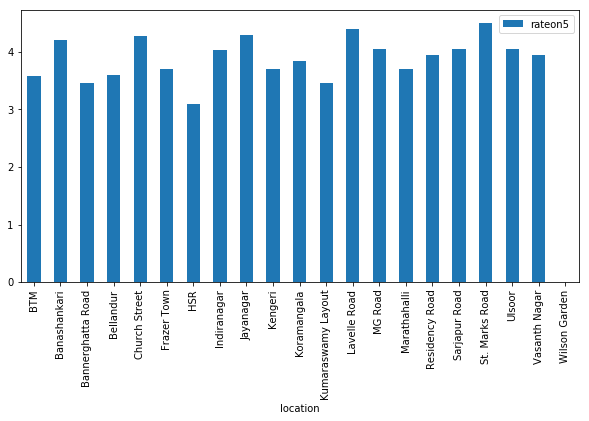

In [50]:
rateboard.plot.bar(x='location', y='rateon5', rot=90,figsize=(10,5))

In [51]:
cafecounts = df.groupby('location')['name'].count().reset_index()

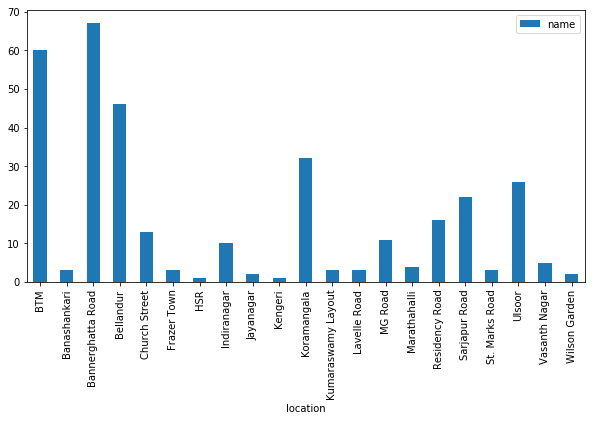

In [52]:
cafecounts.plot.bar(x='location', y='name', rot=90,figsize=(10,5))

In [53]:
cafecounts.shape

(21, 2)

In [54]:
rateboard.shape

(21, 2)

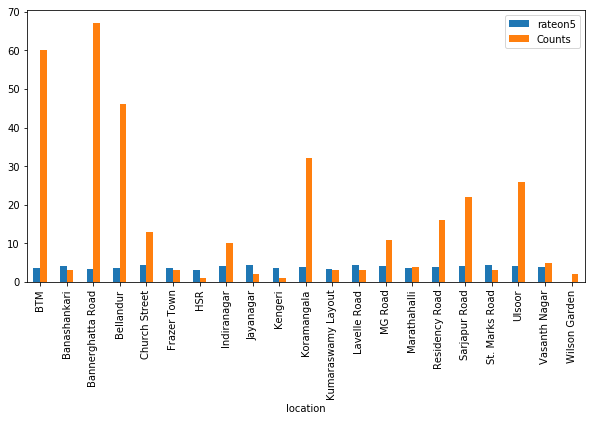

In [55]:
cafeanalysis = rateboard.merge(cafecounts,on='location')
cafeanalysis.rename(columns={'name':'Counts'},inplace=True)
cafeanalysis.set_index('location',inplace=True)
cafeanalysis.plot.bar(rot=90,figsize=(10,5))

In [56]:
df.columns

Index(['name', 'rateon5', 'location', 'lat', 'lng', 'lat_check', 'lng_check'], dtype='object')

In [57]:
df.rateon5 = df.rateon5.fillna(0)

In [58]:
df.head()

,name,rateon5,location,lat,lng,lat_check,lng_check
0,The Coffee Shack,4.2,Banashankari,12.932016,77.547979,True,True
1,Biggies Burger 'n' More,3.6,Kumaraswamy Layout,12.906817,77.563525,True,True
2,Bakers Town,3.8,Kumaraswamy Layout,12.906817,77.563525,True,True
3,The Cafe Nuts and Bolts,3.0,Kumaraswamy Layout,12.906817,77.563525,True,True
4,The Coffee Shack,4.2,Banashankari,12.932016,77.547979,True,True


In [59]:
df.shape

(333, 7)

In [60]:
df = df[df['rateon5']>0]
df.shape

(299, 7)

In [61]:
from sklearn.cluster import KMeans

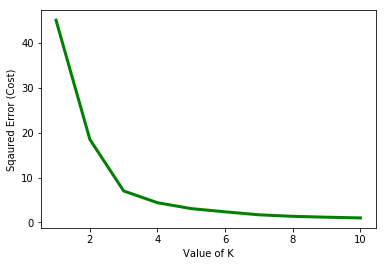

In [62]:
cost =[] 
for i in range(1, 11): 
    KM = KMeans(n_clusters = i, max_iter = 500) 
    KM.fit(df[['lat','lng','rateon5']]) 
    cost.append(KM.inertia_)      
  
plt.plot(range(1, 11), cost, color ='g', linewidth ='3') 
plt.xlabel("Value of K") 
plt.ylabel("Sqaured Error (Cost)") 
plt.show() # clear the plot 
  

In [63]:
 clustering = KMeans(n_clusters=3, random_state=0).fit(df[['lat','lng','rateon5']])

In [64]:
df['cluster'] = clustering.labels_

In [65]:
df.cluster.unique()

array([1, 2, 0], dtype=int64)

In [66]:
df['marker_color'] = pd.cut(df['cluster'], bins=3, 
                              labels=['red','green','yellow'])

In [82]:
df.to_csv('final_zomata.csv',index=False)

In [ ]:
df=pd.read_csv('final_zomata.csv')

In [67]:
df[df.cluster==0]

,name,rateon5,location,lat,lng,lat_check,lng_check,cluster,marker_color
3,The Cafe Nuts and Bolts,3.0,Kumaraswamy Layout,12.906817,77.563525,True,True,0,red
21,Brews N Bites,2.7,Bannerghatta Road,12.887979,77.597081,True,True,0,red
24,Cafe Talk,3.3,Bannerghatta Road,12.887979,77.597081,True,True,0,red
28,Hearts Unlock Cafe,3.2,BTM,12.911276,77.604565,True,True,0,red
37,Trippy Paradise,2.6,BTM,12.911276,77.604565,True,True,0,red
43,Brews N Bites,2.7,Bannerghatta Road,12.887979,77.597081,True,True,0,red
47,Brewz Coffee,3.0,BTM,12.911276,77.604565,True,True,0,red
53,Hearts Unlock Cafe,3.2,BTM,12.911276,77.604565,True,True,0,red
54,Insta Cafe,2.9,BTM,12.911276,77.604565,True,True,0,red
75,Cafe Talk,3.3,Bannerghatta Road,12.887979,77.597081,True,True,0,red


In [68]:
df[df.cluster==1]

,name,rateon5,location,lat,lng,lat_check,lng_check,cluster,marker_color
0,The Coffee Shack,4.2,Banashankari,12.932016,77.547979,True,True,1,green
4,The Coffee Shack,4.2,Banashankari,12.932016,77.547979,True,True,1,green
5,The Coffee Shack,4.2,Banashankari,12.932016,77.547979,True,True,1,green
7,Cafe Kabana,4.0,Bannerghatta Road,12.887979,77.597081,True,True,1,green
38,Bun Town,4.0,BTM,12.911276,77.604565,True,True,1,green
41,Ruh's Cafe,4.1,BTM,12.911276,77.604565,True,True,1,green
62,Cafe Kabana,4.0,Bannerghatta Road,12.887979,77.597081,True,True,1,green
81,Tea Villa Cafe,4.3,Jayanagar,12.926368,77.580725,True,True,1,green
83,Mudpipe Cafe,4.5,BTM,12.911276,77.604565,True,True,1,green
86,Tea Villa Cafe,4.3,Jayanagar,12.926368,77.580725,True,True,1,green


In [69]:
df[df.cluster==2]

,name,rateon5,location,lat,lng,lat_check,lng_check,cluster,marker_color
1,Biggies Burger 'n' More,3.6,Kumaraswamy Layout,12.906817,77.563525,True,True,2,yellow
2,Bakers Town,3.8,Kumaraswamy Layout,12.906817,77.563525,True,True,2,yellow
6,Tisano Cafe,3.8,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
8,Butterly,3.9,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
10,Black Mug Cafe,3.7,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
11,#refuel,3.7,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
12,WAFL,3.9,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
13,Vaho Kafe & Pressery,3.9,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
14,Dreamcatcher,3.9,Bannerghatta Road,12.887979,77.597081,True,True,2,yellow
15,Cafe Coffee Day,3.6,Bannerghatta Road,12.914315,77.599520,True,True,2,yellow


In [77]:
#bangalore = folium.Map(location=nom.geocode('Bangalore')[1], zoom_start=15)
bangalore = folium.Map(location=(12.9716, 77.5946), zoom_start=12)

In [78]:

# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng,colorpin in df[['lat','lng','marker_color']].values:
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=10, # define how big you want the circle markers to be
            color='blue',
            fill=True,
            fill_color=colorpin,
            fill_opacity=0.6
        )
    )
bangalore.add_child(incidents)

In [79]:
df['Label']=df['location']+', '+'('+df['rateon5'].map(str)+')'

In [81]:
# add pop-up text to each marker on the map
for lat, lng, label in df[['lat','lng','Label']].values:
    folium.Marker([lat, lng], popup=label).add_to(bangalore)        
# add incidents to map
bangalore.add_child(incidents)